In [11]:
# Install dependencies
!pip install networkx opencv-python numpy scikit-image matplotlib pandas shapely
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt
%cd ..

# Ensure Matplotlib inline backend
%matplotlib inline
print("Matplotlib backend set to inline")

# --- Imports ---
import torch
import os
import cv2
import numpy as np
import pandas as pd
import networkx as nx
from shapely.geometry import Polygon
import matplotlib.pyplot as plt
from tqdm import tqdm
from skimage.morphology import skeletonize
from google.colab import files
from collections import defaultdict, deque

# Verify networkx
print("NetworkX version:", nx.__version__)

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5
/content
Matplotlib backend set to inline
NetworkX version: 3.5


**Input Handling**

*  Upload microstructure images manually in Colab.
*  Images are processed using a trained YOLOv5 model (`best.pt`) to detect TJs.

In [12]:
# --- YOLOv5 Load Model ---
print("Loading YOLOv5 model...")
try:
    model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/best.pt')
except Exception as e:
    print(f"Error loading model: {e}")
    raise

# --- Upload images from computer ---
print("Uploading images...")
uploaded = files.upload()
image_folder = "/content/local_images"
os.makedirs(image_folder, exist_ok=True)
img_paths = []
for fname, content in uploaded.items():
    path = os.path.join(image_folder, fname)
    with open(path, 'wb') as f:
        f.write(content)
    img_paths.append(path)
print(f"Uploaded {len(img_paths)} images: {img_paths}")

# --- Output Folder ---
output_folder = "/content/local_outputs"
os.makedirs(output_folder, exist_ok=True)
print(f"Output folder created: {output_folder}")

Loading YOLOv5 model...


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2025-6-25 Python-3.11.13 torch-2.6.0+cu124 CPU

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


Uploading images...


Saving slice64_1.png to slice64_1 (1).png
Uploaded 1 images: ['/content/local_images/slice64_1 (1).png']
Output folder created: /content/local_outputs


**Input Image Processing**
- Accepts uploaded grayscale microstructure images.
- Applies Gaussian blur and Canny edge detection to extract boundaries.
- Performs skeletonization using `skimage` to reduce boundaries to one-pixel width.

In [13]:
# --- Edge Processing ---
def preprocess_image(img_path):
    print(f"Preprocessing image: {img_path}")
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Could not load image {img_path}")
        return None, None
    blurred = cv2.GaussianBlur(img, (5, 5), 0)
    edges = cv2.Canny(blurred, 30, 100)
    kernel = np.ones((3, 3), np.uint8)
    closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel, iterations=2)
    dilated = cv2.dilate(closed, kernel, iterations=1)
    skeleton = skeletonize(dilated > 0).astype(np.uint8) * 255
    img_name_no_ext = os.path.splitext(os.path.basename(img_path))[0]
    edge_path = os.path.join(output_folder, f"{img_name_no_ext}_edges.png")
    skeleton_path = os.path.join(output_folder, f"{img_name_no_ext}_skeleton.png")
    cv2.imwrite(edge_path, edges)
    cv2.imwrite(skeleton_path, skeleton)
    print(f"Saved: {edge_path}")
    print(f"Saved: {skeleton_path}")
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
    ax1.imshow(edges, cmap='gray')
    ax1.set_title('Edges')
    ax1.axis('off')
    ax2.imshow(skeleton, cmap='gray')
    ax2.set_title('Skeleton')
    ax2.axis('off')
    plt.tight_layout()
    plt.show()
    print("Displayed edges and skeleton images")
    return img, skeleton


Expected edge result after running the complete code


---
Example usage slice64_1.png used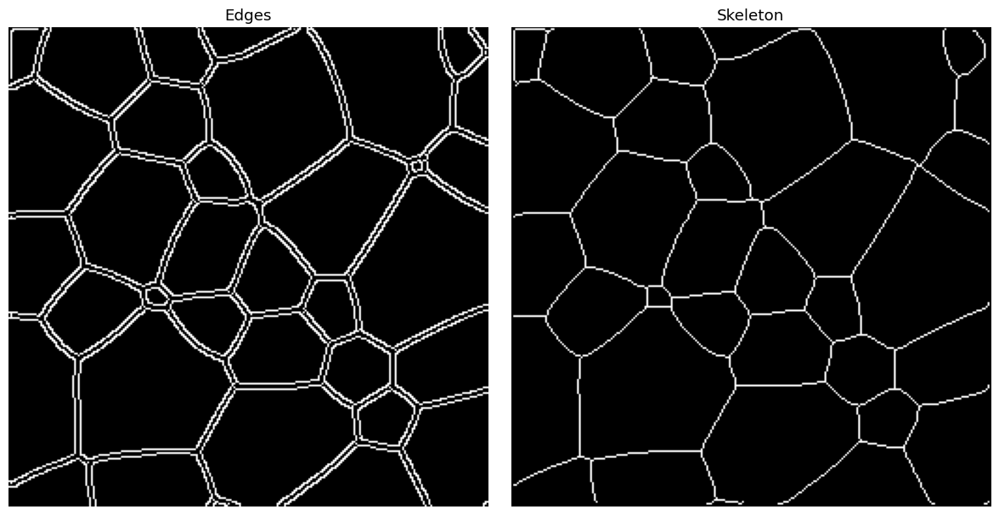


In [14]:
# --- Graph Construction ---
def build_edge_graph(edge_map):
    print("Building edge graph...")
    if edge_map is None:
        print("Error: Edge map is None")
        return None, None
    edge_points = np.argwhere(edge_map > 0)
    if len(edge_points) == 0:
        print("Error: No edge points found in edge map")
        return None, None
    G = nx.Graph()
    point_set = set(map(tuple, edge_points))
    for y, x in edge_points:
        G.add_node((y, x))
        for dy in [-2, -1, 0, 1, 2]:
            for dx in [-2, -1, 0, 1, 2]:
                if dy == 0 and dx == 0:
                    continue
                ny, nx_coord = y + dy, x + dx
                if (ny, nx_coord) in point_set:
                    dist = np.sqrt(dy**2 + dx**2)
                    G.add_edge((y, x), (ny, nx_coord), weight=dist)
    print(f"Edge graph nodes: {G.number_of_nodes()}, edges: {G.number_of_edges()}")
    print(f"Edge points: {len(edge_points)}")
    return G, edge_points

# --- Visualize Edge Graph ---
def visualize_edge_graph(gray_img, edge_graph, edge_points, output_path):
    print(f"Saving edge graph visualization: {output_path}")
    if gray_img is None or edge_graph is None or edge_points is None:
        print("Error: Invalid inputs to visualize_edge_graph")
        return
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(gray_img, cmap='gray')
    x = [p[1] for p in edge_points]
    y = [p[0] for p in edge_points]
    ax.scatter(x, y, c='white', s=1, label='Edge Points')
    for edge in edge_graph.edges():
        x1, y1 = edge[0][1], edge[0][0]
        x2, y2 = edge[1][1], edge[1][0]
        ax.plot([x1, x2], [y1, y2], 'r-', linewidth=0.5)
    ax.legend()
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(output_path)
    plt.show()
    print(f"Saved and displayed: {output_path}")
    plt.close()

Expected graph result after running the complete code


---
Example usage slice64_1.png used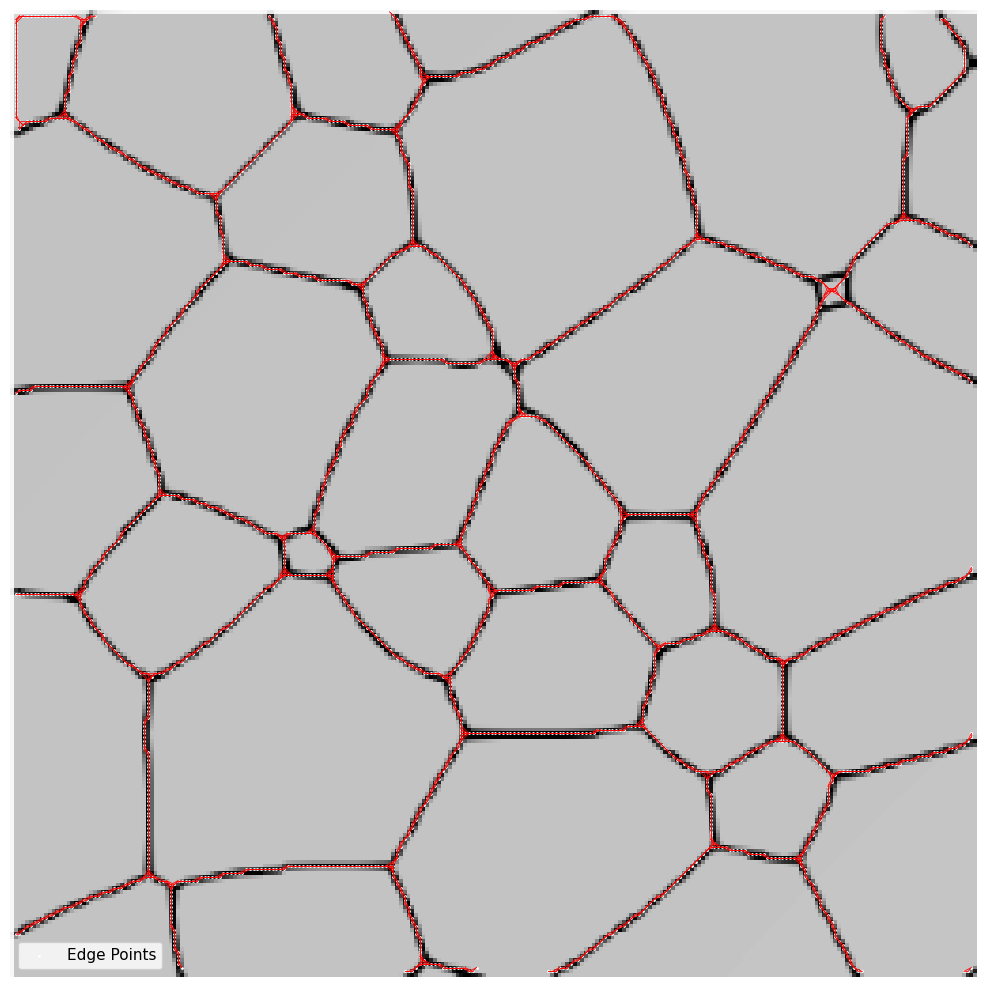

 **Triple Junction  Snapping**
- Aligns detected TJs with nearest edge/skeleton pixels to ensure boundary adherence.

In [15]:
# --- TJ Snap ---
def snap_to_edge_points(points, edge_points, max_snap_dist=20):
    print(f"Snapping {len(points)} TJs to edge points...")
    snapped_points = []
    for px, py in points:
        dists = np.sqrt((edge_points[:,1] - px)**2 + (edge_points[:,0] - py)**2)
        min_idx = np.argmin(dists)
        if dists[min_idx] <= max_snap_dist:
            snapped_points.append(edge_points[min_idx][::-1])
        else:
            snapped_points.append((px, py))
    print(f"Snapped {len(snapped_points)} TJs")
    return np.array(snapped_points)

**Path Tracing Between TJs**
- Searches for TJ-to-TJ paths using directionally constrained breadth-first search.
- Paths must follow real edge flow within max distance and angular bounds.


In [16]:
# --- Trace Path to Next TJ ---
def trace_path_to_next_tj(tj, edge_graph, direction_idx, snapped_tjs, img_shape):
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
    direction_names = ['Up-Left', 'Up', 'Up-Right', 'Left', 'Right', 'Down-Left', 'Down', 'Down-Right']
    dir_dy, dir_dx = directions[direction_idx]
    tj_x, tj_y = tj
    tj_node = (tj_y, tj_x)
    if tj_node not in edge_graph:
        return None, f"No edge point at TJ {tj_x}, {tj_y} in edge graph"
    visited = set()
    queue = deque([(tj_node, [tj_node])])
    visited.add(tj_node)
    max_dist = 200
    tj_set = set(tuple(map(int, t)) for t in snapped_tjs)
    while queue:
        current, path = queue.popleft()
        current_y, current_x = current
        dist = len(path) - 1
        if dist > max_dist:
            return None, f"Reached max distance ({max_dist}) without finding TJ in {direction_names[direction_idx]}"
        if (current_x, current_y) in tj_set and (current_x, current_y) != (tj_x, tj_y):
            return [(x, y) for y, x in path], f"Reached TJ at {current_x}, {current_y} in {direction_names[direction_idx]} (graph distance: {dist})"
        for neighbor in edge_graph.neighbors(current):
            if neighbor not in visited:
                ny, nx = neighbor
                dy, dx = ny - tj_y, nx - tj_x
                if dx == 0 and dy == 0:
                    continue
                norm = np.sqrt(dx**2 + dy**2)
                if norm == 0:
                    continue
                dot_product = dx * dir_dx + dy * dir_dy
                mag_dir = np.sqrt(dir_dx**2 + dir_dy**2)
                if mag_dir == 0:
                    continue
                cosine_angle = np.clip(dot_product / (norm * mag_dir), -1.0, 1.0)
                angle = np.arccos(cosine_angle)
                if angle < np.pi / 4:
                    visited.add(neighbor)
                    queue.append((neighbor, path + [neighbor]))
    return None, f"No TJ reached in {direction_names[direction_idx]} within max distance or no valid edges in direction"

# --- Save TJ and Neighbors to Text ---
def save_tj_and_neighbors_to_txt(snapped_tjs, edge_graph, output_path, img_shape):
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
    direction_names = ['Up-Left', 'Up', 'Up-Right', 'Left', 'Right', 'Down-Left', 'Down', 'Down-Right']
    with open(output_path, 'w') as f:
        f.write("Snapped Triple Junctions, Up to 10 Neighboring Edge Points, and Paths Along Edge Graph (x, y):\n")
        for i, tj in enumerate(snapped_tjs):
            tj = tuple(map(int, tj))
            f.write(f"\nTriple Junction {i+1}: {tj[0]}, {tj[1]}\n")
            points_by_direction = defaultdict(list)
            visited = set()
            queue = deque([(tj[1], tj[0])])
            visited.add((tj[1], tj[0]))
            level = defaultdict(list)
            level[0].append((tj[1], tj[0]))
            while queue:
                current = queue.popleft()
                current_level = -1
                for lvl, nodes in level.items():
                    if current in nodes:
                        current_level = lvl
                        break
                if current_level == -1 or current_level >= 10:
                    break
                for neighbor in edge_graph.neighbors(current):
                    if neighbor not in visited:
                        visited.add(neighbor)
                        queue.append(neighbor)
                        level[current_level + 1].append(neighbor)
                        dy, dx = neighbor[0] - tj[1], neighbor[1] - tj[0]
                        if dx == 0 and dy == 0:
                            continue
                        for dir_idx, (dir_dy, dir_dx) in enumerate(directions):
                            dot_product = dx * dir_dx + dy * dir_dy
                            mag_current = np.sqrt(dx**2 + dy**2)
                            mag_dir = np.sqrt(dir_dx**2 + dir_dy**2)
                            if mag_current == 0 or mag_dir == 0:
                                continue
                            if dot_product > 0:
                                angle = np.arccos(np.clip(dot_product / (mag_current * mag_dir), -1.0, 1.0))
                                if angle < np.pi / 4:
                                    points_by_direction[dir_idx].append((neighbor[1], neighbor[0]))
                                    break
            for dir_idx, direction in enumerate(direction_names):
                f.write(f"  {direction}:\n")
                f.write("    Neighboring Edge Points:\n")
                points = points_by_direction[dir_idx][:10]
                if points:
                    for x, y in points:
                        f.write(f"      {x:.1f}, {y:.1f}\n")
                else:
                    f.write("      No points in this direction.\n")
                f.write("    Path to Next TJ Along Edge Graph:\n")
                path, reason = trace_path_to_next_tj(tj, edge_graph, dir_idx, snapped_tjs, img_shape)
                if path:
                    for x, y in path:
                        f.write(f"      {x:.2f}, {y:.2f}\n")
                    f.write(f"      Reason: {reason}\n")
                else:
                    f.write(f"      No path found. Reason: {reason}\n")
    print(f"Saved TJ neighbors to: {output_path}")
    return points_by_direction

# --- Visualize TJ Neighbors ---
def visualize_tj_neighbors(gray_img, snapped_tjs, edge_graph, output_path):
    print(f"Saving TJ neighbors visualization: {output_path}")
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
    direction_names = ['Up-Left', 'Up', 'Up-Right', 'Left', 'Right', 'Down-Left', 'Down', 'Down-Right']
    direction_colors = {
        'Up-Left': 'red', 'Up': 'blue', 'Up-Right': 'green', 'Left': 'purple',
        'Right': 'orange', 'Down-Left': 'yellow', 'Down': 'pink', 'Down-Right': 'brown'
    }
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(gray_img, cmap='gray')
    ax.scatter(snapped_tjs[:, 0], snapped_tjs[:, 1], c='cyan', s=50, marker='o', label='Snapped TJs')
    for i, tj in enumerate(snapped_tjs):
        tj = tuple(map(int, tj))
        points_by_direction = defaultdict(list)
        visited = set()
        queue = deque([(tj[1], tj[0])])
        visited.add((tj[1], tj[0]))
        level = defaultdict(list)
        level[0].append((tj[1], tj[0]))
        while queue:
            current = queue.popleft()
            current_level = -1
            for lvl, nodes in level.items():
                if current in nodes:
                    current_level = lvl
                    break
            if current_level == -1 or current_level >= 10:
                break
            for neighbor in edge_graph.neighbors(current):
                if neighbor not in visited:
                    visited.add(neighbor)
                    queue.append(neighbor)
                    level[current_level + 1].append(neighbor)
                    dy, dx = neighbor[0] - tj[1], neighbor[1] - tj[0]
                    if dx == 0 and dy == 0:
                        continue
                    for dir_idx, (dir_dy, dir_dx) in enumerate(directions):
                        dot_product = dx * dir_dx + dy * dir_dy
                        mag_current = np.sqrt(dx**2 + dy**2)
                        mag_dir = np.sqrt(dir_dx**2 + dir_dy**2)
                        if mag_current == 0 or mag_dir == 0:
                            continue
                        if dot_product > 0:
                            angle = np.arccos(np.clip(dot_product / (mag_current * mag_dir), -1.0, 1.0))
                            if angle < np.pi / 4:
                                points_by_direction[dir_idx].append((neighbor[1], neighbor[0]))
                                break
        for dir_idx, direction in enumerate(direction_names):
            points = points_by_direction[dir_idx][:10]
            if points:
                x = [p[0] for p in points]
                y = [p[1] for p in points]
                ax.scatter(x, y, c=direction_colors[direction], s=20, marker='x',
                          label=f'TJ {i+1} {direction}' if i == 0 else None)
            path, _ = trace_path_to_next_tj(tj, edge_graph, dir_idx, snapped_tjs, gray_img.shape)
            if path:
                x = [p[0] for p in path]
                y = [p[1] for p in path]
                ax.plot(x, y, c=direction_colors[direction], linewidth=1,
                        linestyle='-', label=f'TJ {i+1} {direction} Path' if i == 0 else None)
    ax.legend()
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(output_path)
    plt.show()
    print(f"Saved and displayed: {output_path}")
    plt.close()


Expected neighbours and path result after running the complete code


---
Example usage slice64_1.png used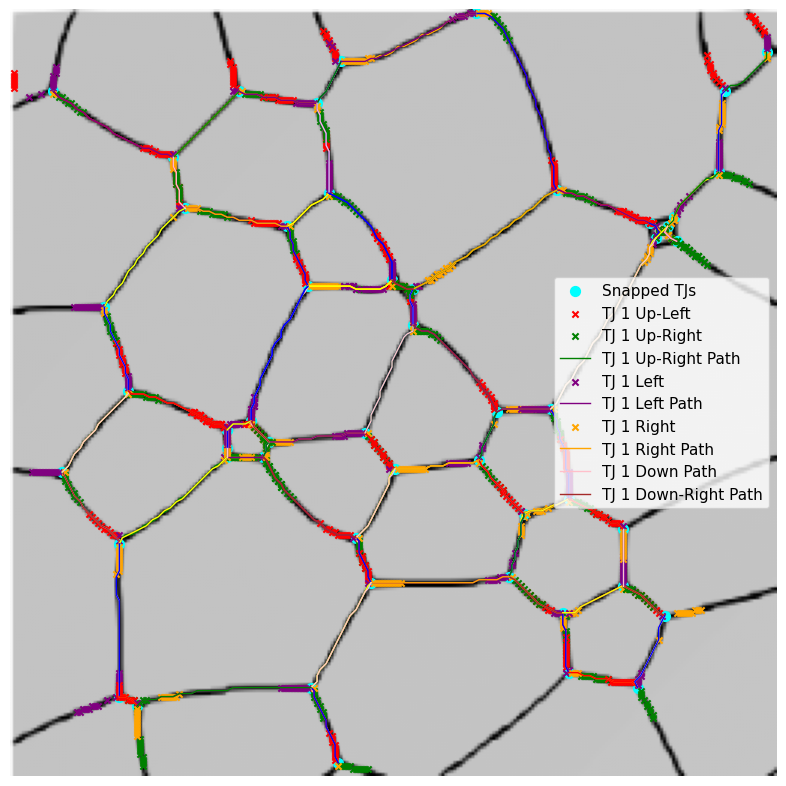

In [17]:
# --- Visualize Individual Direction Path ---
def visualize_individual_direction_path(gray_img, path, tj, tj_idx, direction_idx, snapped_tjs, output_path):
    print(f"Generating path image: {output_path}")
    direction_names = ['Up-Left', 'Up', 'Up-Right', 'Left', 'Right', 'Down-Left', 'Down', 'Down-Right']
    direction = direction_names[direction_idx].lower().replace('-', '')
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(gray_img, cmap='gray')
    ax.scatter(snapped_tjs[:, 0], snapped_tjs[:, 1], c='cyan', s=50, marker='o', label='Snapped TJs')
    ax.scatter([tj[0]], [tj[1]], c='magenta', s=100, marker='*', label=f'TJ {tj_idx+1}')
    if path:
        x = [p[0] for p in path]
        y = [p[1] for p in path]
        ax.plot(x, y, c='red', linewidth=2, linestyle='-', label=f'TJ {tj_idx+1} {direction_names[direction_idx]} Path')
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(output_path, bbox_inches='tight')
    plt.show()
    print(f"Saved and displayed: {output_path}")
    plt.close()

Expected individual path result after running the complete code


---
Example usage slice64_1.png used showing one of its path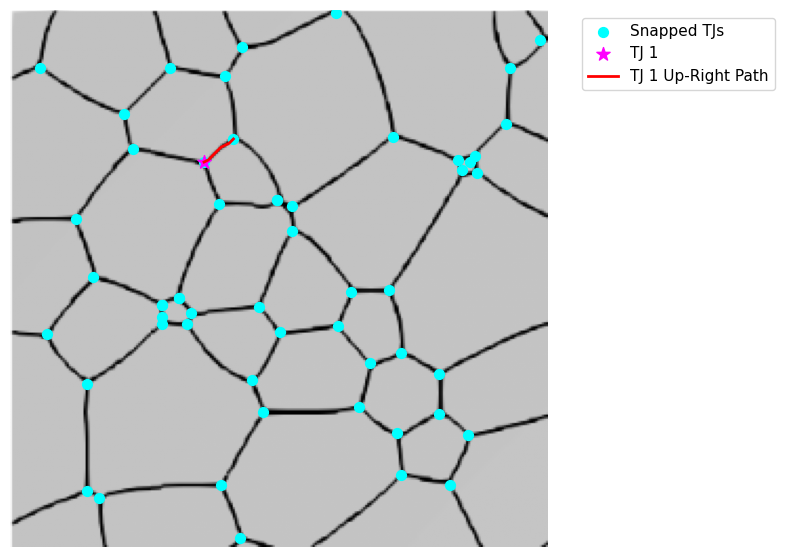

*Polygon (Grain) Reconstruction and Visualization**
- Uses TJs as vertices and TJ-paths as edges to form polygonal loops.
- Validates polygons (area, shape, self-intersections, overlaps).
- Number of sides, area (using Shoelace formula), neighbors, and averages.
- Saves all results to CSV
- Individual polygon images with TJ labels and centroids.
- Combined polygon overlays with unique colors and grain indices.

In [18]:
# --- Reconstruct Polygons ---
def reconstruct_polygons(vertices, edges, output_txt_path, output_img_path, gray_img, snapped_tjs, input_img_path):
    print(f"Reconstructing polygons...")
    if gray_img is None:
        print("Error: gray_img is None")
        return []
    unique_vertices = []
    vertex_map = {}
    for i, v in enumerate(vertices):
        v_tuple = tuple(v)
        if v_tuple not in vertex_map:
            vertex_map[v_tuple] = len(unique_vertices)
            unique_vertices.append(v)
        vertex_map[i] = vertex_map[v_tuple]
    print(f"Vertices before deduplication: {len(vertices)}, after: {len(unique_vertices)}")
    remapped_edges = []
    for u, v in edges:
        new_u = vertex_map[u]
        new_v = vertex_map[v]
        if new_u != new_v:
            remapped_edges.append((new_u, new_v))
    vertices = unique_vertices
    edges = remapped_edges
    print(f"Edges after deduplication: {len(edges)}")
    adj_map = defaultdict(list)
    edge_set = set()
    degree = defaultdict(int)
    for u, v in edges:
        if np.sqrt((vertices[u][0] - vertices[v][0])**2 + (vertices[u][1] - vertices[v][1])**2) <= 150:
            adj_map[u].append(v)
            adj_map[v].append(u)
            edge_set.add((u, v))
            edge_set.add((v, u))
            degree[u] += 1
            degree[v] += 1
    print(f"Vertices with degree >= 3: {sum(1 for d in degree.values() if d >= 3)}")
    for v in [8, 24, 47]:
        print(f"Vertex {v} degree: {degree.get(v, 0)}, neighbors: {adj_map.get(v, [])}")
    edge_usage = defaultdict(int)
    polygons = []
    img_area = gray_img.shape[0] * gray_img.shape[1]

    def compute_ccw_angle(prev_v, curr_v, next_v):
        v1 = np.array(vertices[prev_v]) - np.array(vertices[curr_v])
        v2 = np.array(vertices[next_v]) - np.array(vertices[curr_v])
        angle1 = np.arctan2(v1[1], v1[0])
        angle2 = np.arctan2(v2[1], v2[0])
        angle = (angle2 - angle1) % (2 * np.pi)
        return angle

    def is_valid_polygon(poly):
        if len(poly) < 4:
            print(f"Rejected polygon {poly}: Too few vertices")
            return False
        if poly[0] != poly[-1]:
            print(f"Rejected polygon {poly}: Not closed")
            return False
        try:
            coords = [vertices[i] for i in poly[:-1]]
            poly_obj = Polygon(coords)
            if not poly_obj.is_valid or not poly_obj.is_simple:
                print(f"Rejected polygon {poly}: Invalid or self-intersecting")
                return False
            if poly_obj.area < 0.002 or poly_obj.area > 0.5 * img_area:
                print(f"Rejected polygon {poly}: Area {poly_obj.area} outside bounds")
                return False
            for existing_poly in polygons:
                existing_coords = [vertices[i] for i in existing_poly[:-1]]
                existing_poly_obj = Polygon(existing_coords)
                if poly_obj.intersects(existing_poly_obj) and not poly_obj.touches(existing_poly_obj):
                    print(f"Rejected polygon {poly}: Overlaps with existing polygon")
                    return False
            print(f"Valid polygon {poly}: Area {poly_obj.area}")
            return True
        except Exception as e:
            print(f"Rejected polygon {poly}: Shapely error {e}")
            return False

    def trace_polygon(start_v, start_edge_v, max_attempts=3):
        for attempt in range(max_attempts):
            poly = [start_v, start_edge_v]
            curr_v = start_edge_v
            prev_v = start_v
            visited_vertices = {start_v, start_edge_v}
            temp_edge_usage = edge_usage.copy()
            while curr_v != start_v or len(poly) < 4:
                neighbors = [
                    n for n in adj_map[curr_v]
                    if n != prev_v and temp_edge_usage[tuple(sorted([curr_v, n]))] < 2
                    and (n not in visited_vertices or n == start_v)
                ]
                if not neighbors:
                    print(f"Incomplete polygon {poly}: No valid neighbors at {curr_v}, attempt {attempt+1}")
                    break
                angles = [(n, compute_ccw_angle(prev_v, curr_v, n)) for n in neighbors]
                angles.sort(key=lambda x: x[1])
                for next_v, _ in angles[:min(len(angles), attempt + 1)]:
                    poly.append(next_v)
                    temp_edge_usage[tuple(sorted([curr_v, next_v]))] += 1
                    if next_v == start_v and len(poly) >= 4:
                        if is_valid_polygon(poly):
                            for i in range(len(poly) - 1):
                                edge_usage[tuple(sorted([poly[i], poly[i + 1]]))] += 1
                            return poly
                        poly.pop()
                        temp_edge_usage[tuple(sorted([curr_v, next_v]))] -= 1
                        continue
                    if next_v in visited_vertices and next_v != start_v:
                        print(f"Incomplete polygon {poly}: Revisited vertex {next_v}, attempt {attempt+1}")
                        poly.pop()
                        temp_edge_usage[tuple(sorted([curr_v, next_v]))] -= 1
                        continue
                    visited_vertices.add(next_v)
                    prev_v = curr_v
                    curr_v = next_v
                    break
                else:
                    print(f"Incomplete polygon {poly}: No valid next vertex, attempt {attempt+1}")
                    break
                if len(poly) > 100:
                    print(f"Aborted polygon: Exceeded max vertices at {curr_v}, attempt {attempt+1}")
                    break
            if poly[-1] == start_v and len(poly) >= 4 and is_valid_polygon(poly):
                for i in range(len(poly) - 1):
                    edge_usage[tuple(sorted([poly[i], poly[i + 1]]))] += 1
                return poly
        return None

    sorted_edges = sorted(edge_set, key=lambda e: (-degree[e[0]], -degree[e[1]]))
    for u, v in sorted_edges:
        if degree[u] < 3 or degree[v] < 3:
            continue
        if edge_usage[tuple(sorted([u, v]))] >= 2:
            continue
        for start_v in [u, v]:
            poly = trace_polygon(start_v, v if start_v == u else u)
            if poly:
                poly_tuple = tuple(poly)
                if poly_tuple not in set(map(tuple, polygons)):
                    polygons.append(poly)
                    print(f"Added polygon: {poly}")
                    min_idx = poly[:-1].index(min(poly[:-1]))
                    normalized = poly[min_idx:-1] + poly[:min_idx] + [poly[min_idx]]
                    polygons[-1] = normalized

    print(f"Total polygons formed: {len(polygons)}")
    with open(output_txt_path, 'w') as f:
        f.write("Reconstructed Polygons (TJ Indices and Coordinates):\n")
        for i, poly in enumerate(polygons):
            f.write(f"\nPolygon {i+1}:\n")
            f.write("TJ Indices: " + ", ".join(str(v+1) for v in poly[:-1]) + "\n")
            f.write("Coordinates (x, y):\n")
            for v in poly[:-1]:
                x, y = vertices[v]
                f.write(f"  {x:.2f}, {y:.2f}\n")

    num_sides = []
    neighbors = defaultdict(list)
    areas = []
    behaviors = []
    for i, poly in enumerate(polygons):
        sides = len(poly) - 1
        num_sides.append(sides)
        coords = [vertices[v] for v in poly[:-1]]
        x = [c[0] for c in coords]
        y = [c[1] for c in coords]
        area = 0.5 * abs(sum(x[i] * y[i+1] - y[i] * x[i+1] for i in range(len(coords)-1)) +
                         x[-1] * y[0] - y[-1] * x[0])
        areas.append(area)
        behaviors.append("Shrink" if sides < 6 else "Grow")
        poly_edges = set(tuple(sorted([poly[j], poly[j+1]])) for j in range(len(poly)-1))
        for j, other_poly in enumerate(polygons):
            if i == j:
                continue
            other_edges = set(tuple(sorted([other_poly[k], other_poly[k+1]])) for k in range(len(other_poly)-1))
            if poly_edges & other_edges:
                neighbors[i].append(j + 1)
    avg_area = np.mean(areas) if areas else 0.0
    avg_neighbor_areas = []
    avg_neighbor_sides = []
    for i in range(len(polygons)):
        neighbor_indices = neighbors[i]
        if neighbor_indices:
            neighbor_areas = [areas[j-1] for j in neighbor_indices]
            neighbor_sides = [num_sides[j-1] for j in neighbor_indices]
            avg_neighbor_areas.append(np.mean(neighbor_areas))
            avg_neighbor_sides.append(np.mean(neighbor_sides))
        else:
            avg_neighbor_areas.append(0.0)
            avg_neighbor_sides.append(0.0)

    img_name_no_ext = os.path.splitext(os.path.basename(input_img_path))[0]
    csv_path = os.path.join(os.path.dirname(output_img_path), f"{img_name_no_ext}_grain_properties.csv")
    df_properties = pd.DataFrame({
        'Polygon_Index': [i+1 for i in range(len(polygons))],
        'Num_Sides': num_sides,
        'Neighbors': [','.join(map(str, neighbors[i])) if neighbors[i] else '' for i in range(len(polygons))],
        'Area': areas,
        'Average_Area': [avg_area] * len(polygons),
        'Average_Neighbor_Area': avg_neighbor_areas,
        'Average_Neighbor_Sides': avg_neighbor_sides,
        'Behavior': behaviors
    })
    df_properties.to_csv(csv_path, index=False)
    print(f"Saved grain properties to: {csv_path}")
    print("\nGrain Properties DataFrame:")
    print(df_properties)

    input_img = cv2.imread(input_img_path)
    if input_img is None:
        print(f"Error loading input image: {input_img_path}")
        input_img = gray_img
    if len(input_img.shape) == 2:
        input_img = cv2.cvtColor(input_img, cv2.COLOR_GRAY2RGB)
    else:
        input_img = cv2.cvtColor(input_img, cv2.COLOR_BGR2RGB)

    for i, poly in enumerate(polygons):
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.imshow(input_img, alpha=0.5)
        ax.scatter(snapped_tjs[:, 0], snapped_tjs[:, 1], c='cyan', s=50, marker='o', label='Snapped TJs')
        coords = [vertices[v] for v in poly]
        x = [c[0] for c in coords]
        y = [c[1] for c in coords]
        color = 'red' if len(poly) - 1 < 6 else 'black'
        ax.plot(x, y, c=color, linewidth=2, label=f'Polygon {i+1}')
        centroid_x = np.mean(x[:-1])
        centroid_y = np.mean(y[:-1])
        ax.text(centroid_x, centroid_y, str(i+1), color='white', fontsize=12, ha='center', va='center',
                bbox=dict(facecolor='black', alpha=0.5, edgecolor='none'))
        ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        ax.axis('off')
        plt.tight_layout()
        output_individual_path = os.path.join(os.path.dirname(output_img_path), f"{img_name_no_ext}_polygon_{i+1}.png")
        plt.savefig(output_individual_path, bbox_inches='tight')
        plt.show()
        print(f"Saved and displayed individual polygon visualization: {output_individual_path}")
        plt.close()

    fig, ax = plt.subplots(figsize=(8, 8))
    ax.imshow(input_img, alpha=0.5)
    ax.scatter(snapped_tjs[:, 0], snapped_tjs[:, 1], c='cyan', s=50, marker='o', label='Snapped TJs')
    for i, poly in enumerate(polygons):
        coords = [vertices[v] for v in poly]
        x = [c[0] for c in coords]
        y = [c[1] for c in coords]
        color = 'red' if len(poly) - 1 < 6 else 'black'
        ax.plot(x, y, c=color, linewidth=2, label=f'Polygon {i+1} ({len(poly)-1} sides)')
        centroid_x = np.mean(x[:-1])
        centroid_y = np.mean(y[:-1])
        ax.text(centroid_x, centroid_y, str(i+1), color='white', fontsize=12, ha='center', va='center',
                bbox=dict(facecolor='black', alpha=0.5, edgecolor='none'))
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.axis('off')
    plt.tight_layout()
    plt.savefig(output_img_path, bbox_inches='tight')
    plt.show()
    print(f"Saved and displayed combined polygon visualization: {output_img_path}")
    plt.close()
    return polygons

Expected individual and combined polygons result after running the complete code


---
Example usage slice64_1.png used showing one of its grain polygon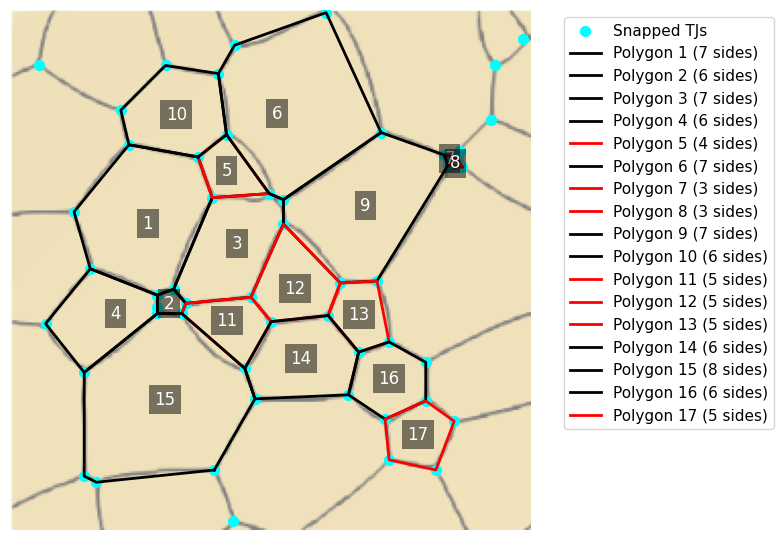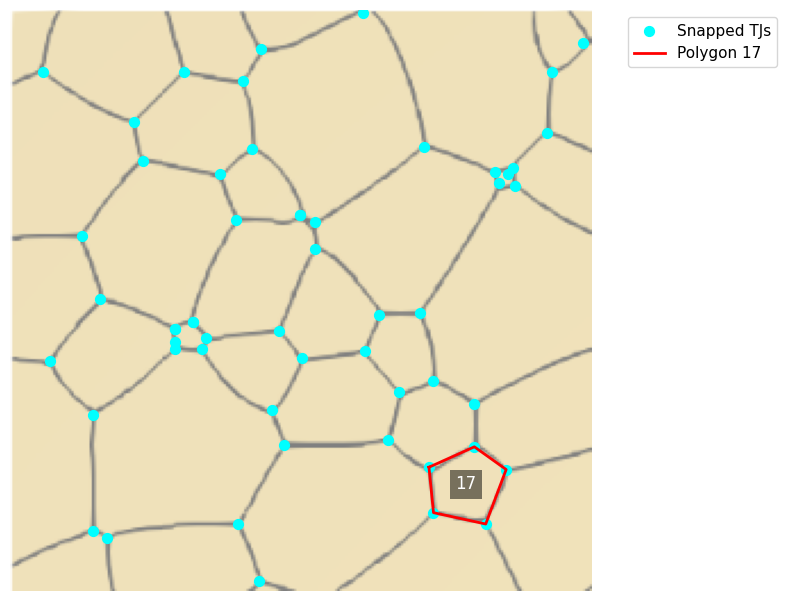

Starting main loop...


  0%|          | 0/1 [00:00<?, ?it/s]


Processing image: /content/local_images/slice64_1 (1).png


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Detected 55 TJs
Preprocessing image: /content/local_images/slice64_1 (1).png
Saved: /content/local_outputs/slice64_1 (1)_edges.png
Saved: /content/local_outputs/slice64_1 (1)_skeleton.png


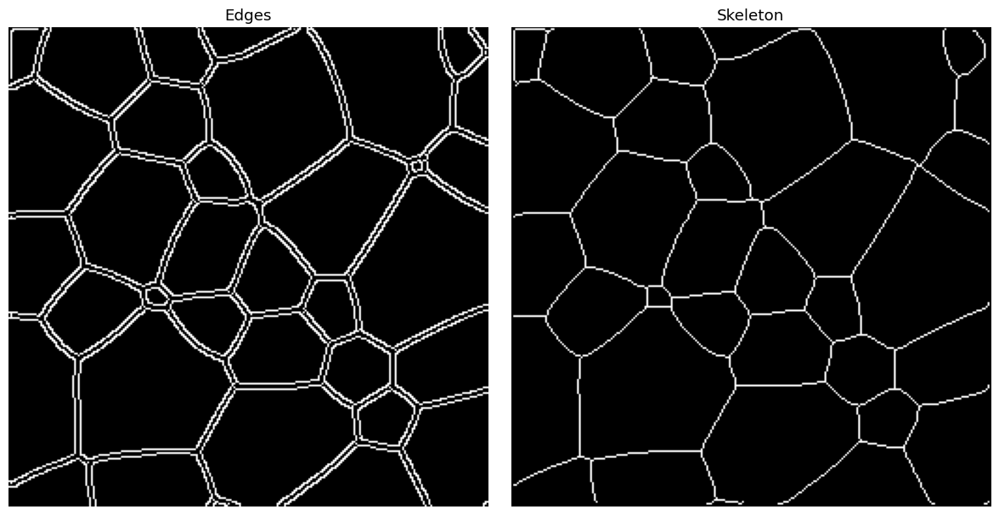

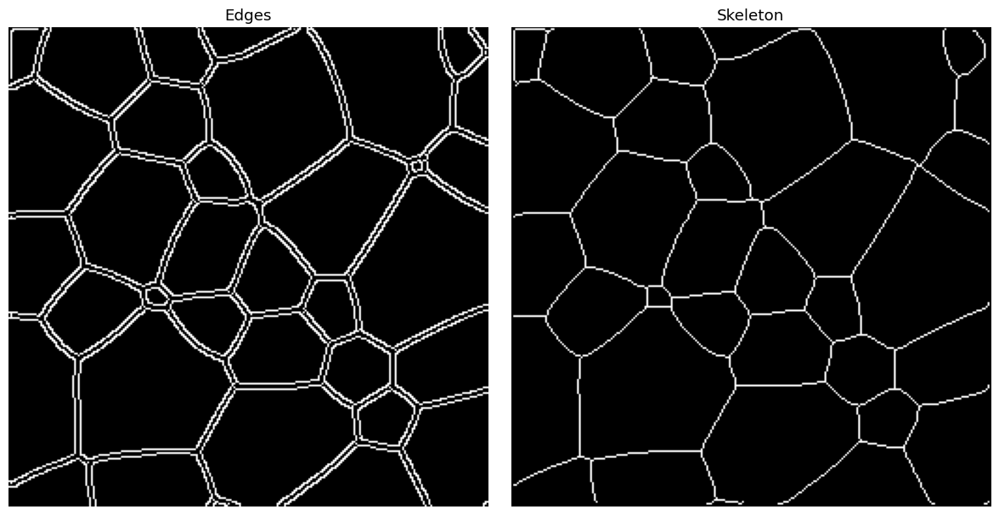

Displayed edges and skeleton images
Building edge graph...
Edge graph nodes: 2111, edges: 4504
Edge points: 2111
Saving edge graph visualization: /content/local_outputs/slice64_1 (1)_edge_graph.png


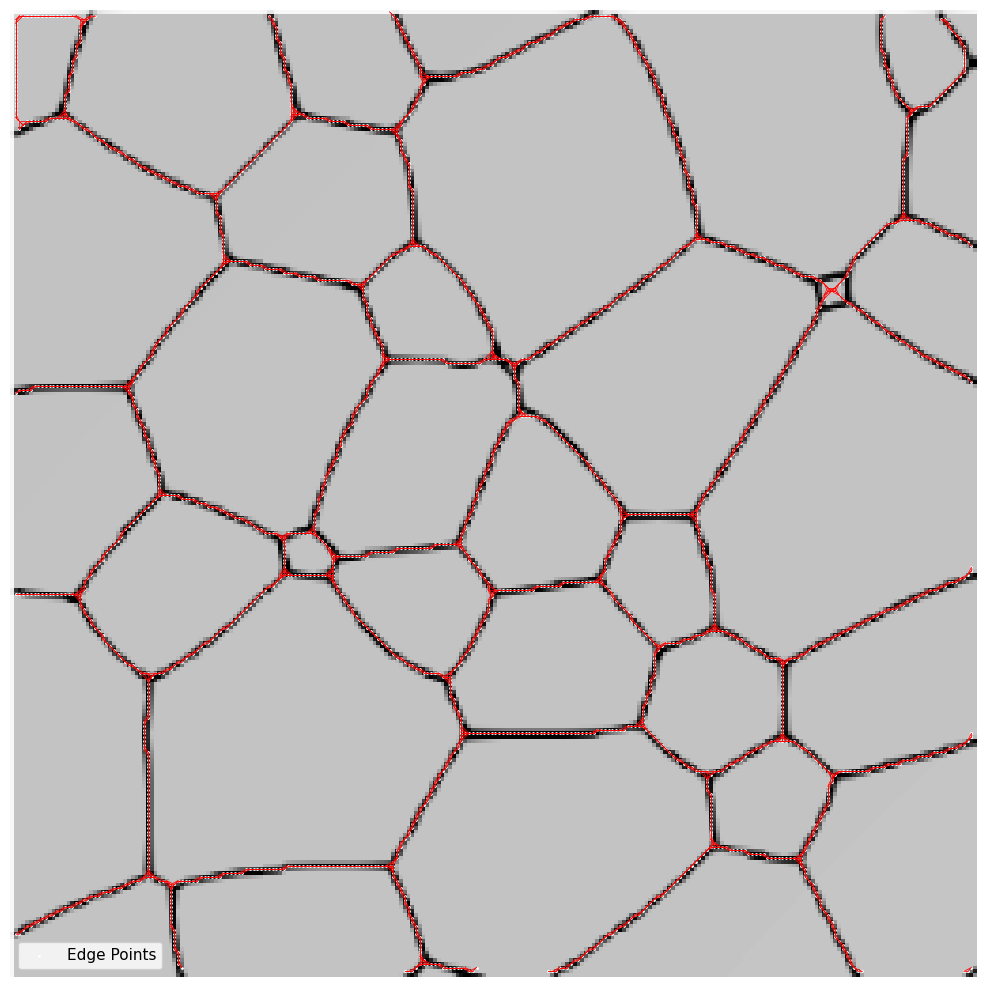

Saved and displayed: /content/local_outputs/slice64_1 (1)_edge_graph.png
Snapping 55 TJs to edge points...
Snapped 55 TJs
Snapped TJs: 55
[[ 92  72]
 [182  60]
 [162 134]
 [180 133]
 [156 150]
 [100 226]
 [ 99  92]
 [184 201]
 [109 251]
 [ 72 140]
 [ 36 178]
 [ 31  99]
 [238  27]
 [110  17]
 [171 168]
 [218 202]
 [186 163]
 [186 221]
 [ 17 154]
 [106  61]
 [222  77]
 [213  71]
 [ 58  66]
 [ 39 127]
 [ 14  27]
 [166 189]
 [ 76  27]
 [115 176]
 [ 80 137]
 [ 72 149]
 [ 54  49]
 [102  31]
 [236  54]
 [204 192]
 [134  93]
 [120 191]
 [ 86 144]
 [209 226]
 [221  69]
 [ 36 229]
 [118 141]
 [215  76]
 [128 153]
 [134 105]
 [ 42 232]
 [ 84 149]
 [204 173]
 [252  14]
 [127  90]
 [ 72 140]
 [127  90]
 [155   1]
 [219  72]
 [ 72 146]
 [ 80 137]]
Saved TJ neighbors to: /content/local_outputs/slice64_1 (1)_tj_neighbors.txt
Saving TJ neighbors visualization: /content/local_outputs/slice64_1 (1)_tj_outputs.png


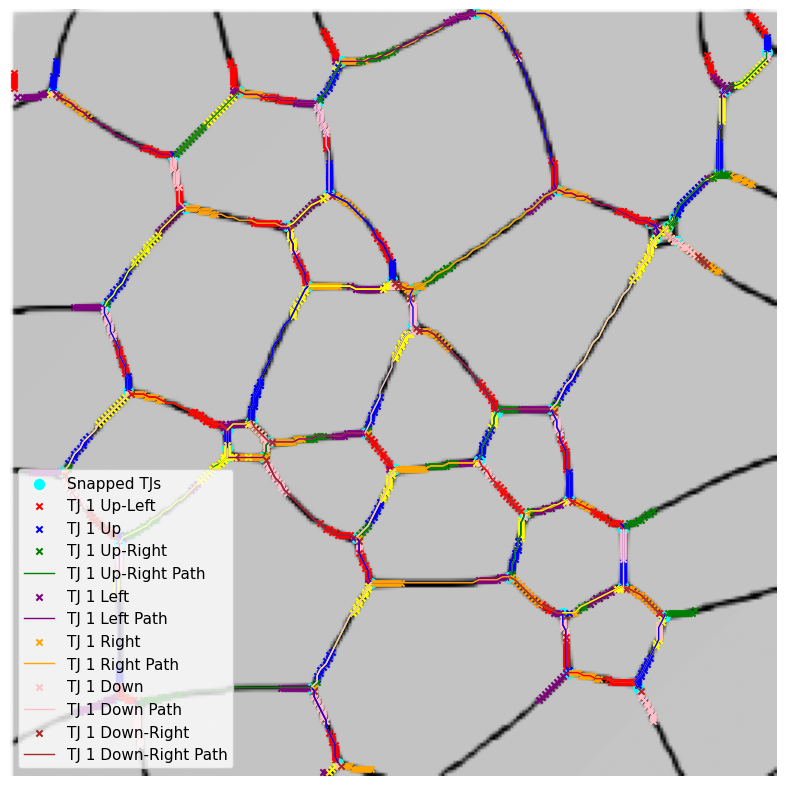

Saved and displayed: /content/local_outputs/slice64_1 (1)_tj_outputs.png
Generating unique TJ pair path images and saving paths to text file...
No path for TJ 1 Up-Left: No TJ reached in Up-Left within max distance or no valid edges in direction
No path for TJ 1 Up: No TJ reached in Up within max distance or no valid edges in direction
No path for TJ 1 Down-Left: No TJ reached in Down-Left within max distance or no valid edges in direction
No path for TJ 2 Up-Right: No TJ reached in Up-Right within max distance or no valid edges in direction
No path for TJ 2 Down: No TJ reached in Down within max distance or no valid edges in direction
No path for TJ 2 Down-Right: No TJ reached in Down-Right within max distance or no valid edges in direction
No path for TJ 3 Left: No TJ reached in Left within max distance or no valid edges in direction
No path for TJ 3 Down-Right: No TJ reached in Down-Right within max distance or no valid edges in direction
No path for TJ 4 Up-Left: No TJ reached in U

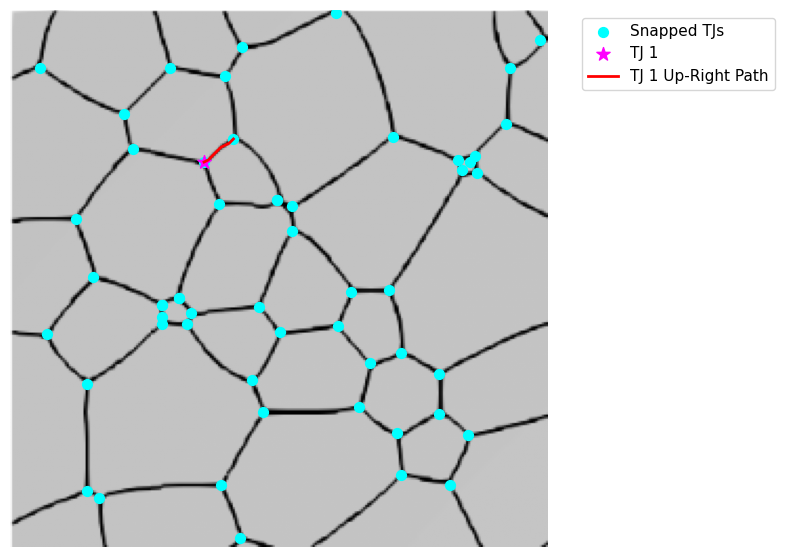

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_1_to_tj_20.png
Path plotted for TJ 1 to TJ 20 (via Up-Right): Reached TJ at 106, 61 in Up-Right (graph distance: 7)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_1_to_tj_23.png


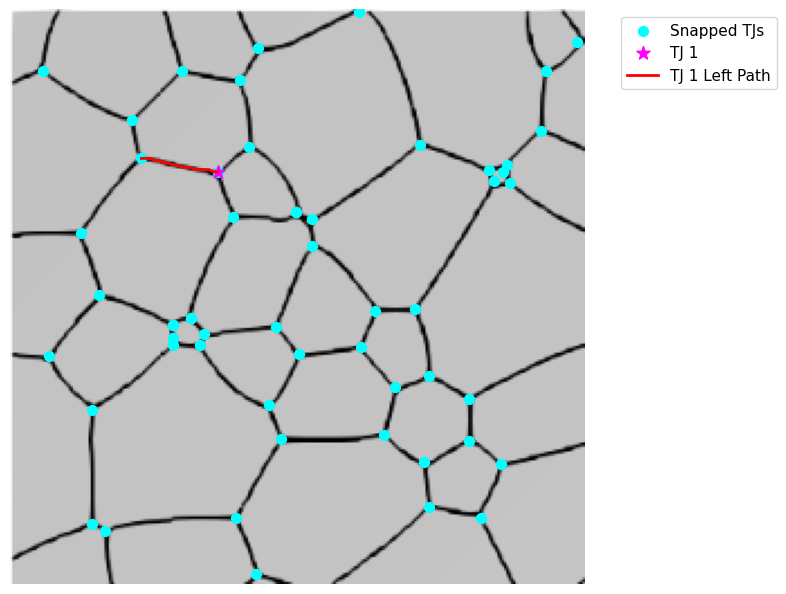

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_1_to_tj_23.png
Path plotted for TJ 1 to TJ 23 (via Left): Reached TJ at 58, 66 in Left (graph distance: 17)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_1_to_tj_7.png


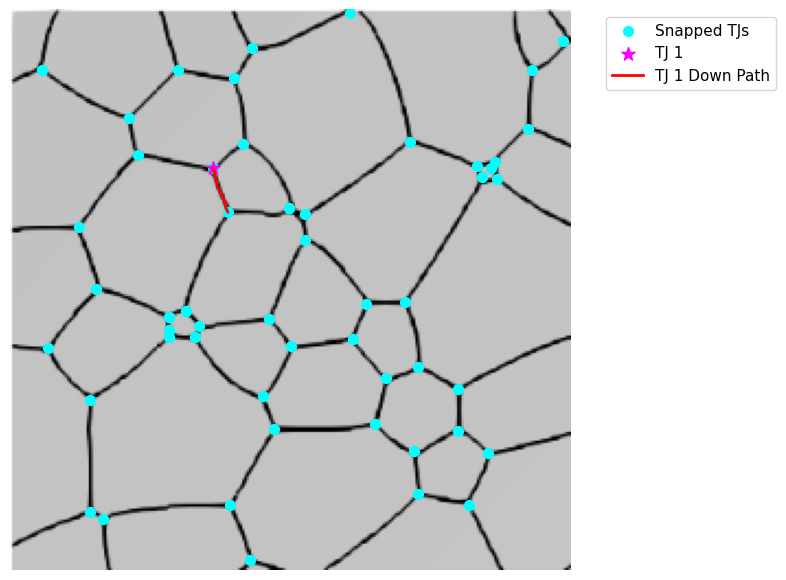

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_1_to_tj_7.png
Path plotted for TJ 1 to TJ 7 (via Down): Reached TJ at 99, 92 in Down (graph distance: 10)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_2_to_tj_52.png


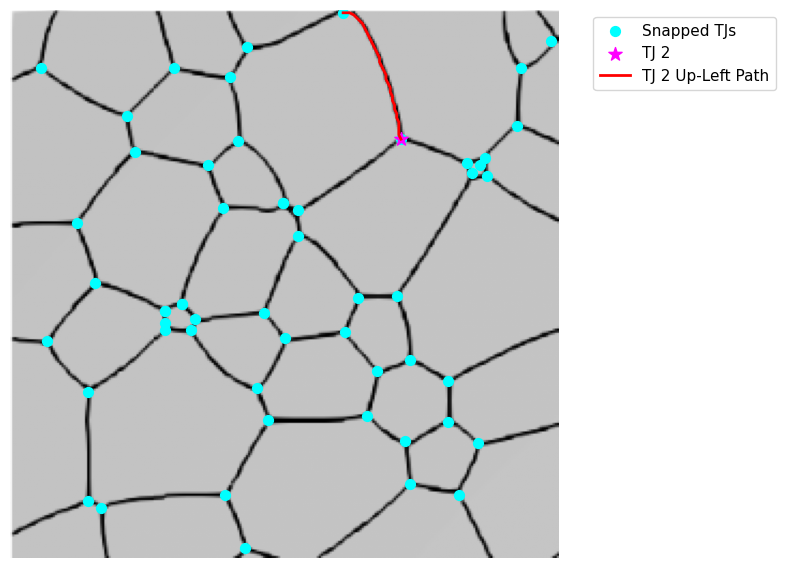

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_2_to_tj_52.png
Path plotted for TJ 2 to TJ 52 (via Up-Left): Reached TJ at 155, 1 in Up-Left (graph distance: 32)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_2_to_tj_35.png


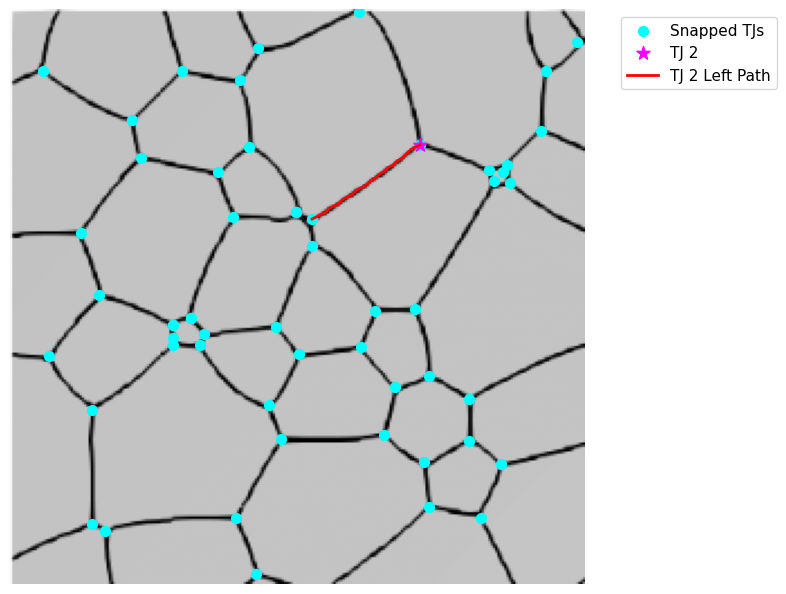

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_2_to_tj_35.png
Path plotted for TJ 2 to TJ 35 (via Left): Reached TJ at 134, 93 in Left (graph distance: 24)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_2_to_tj_22.png


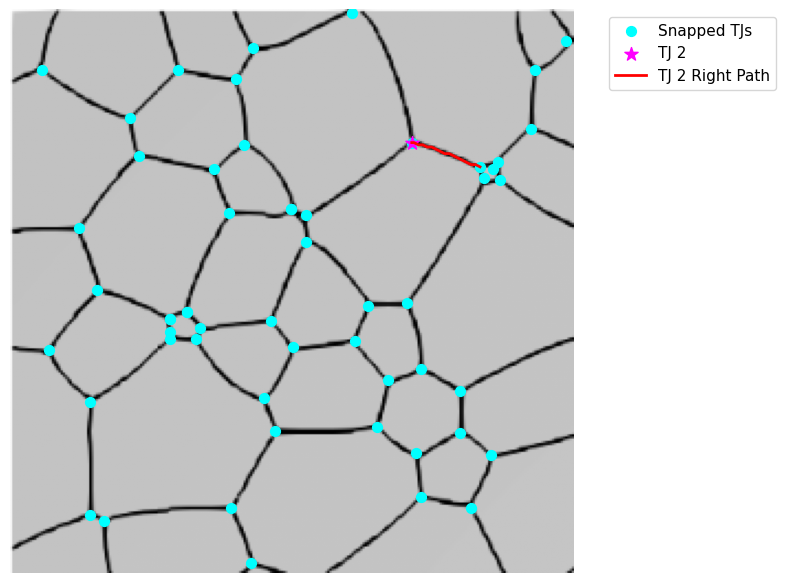

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_2_to_tj_22.png
Path plotted for TJ 2 to TJ 22 (via Right): Reached TJ at 213, 71 in Right (graph distance: 16)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_3_to_tj_44.png


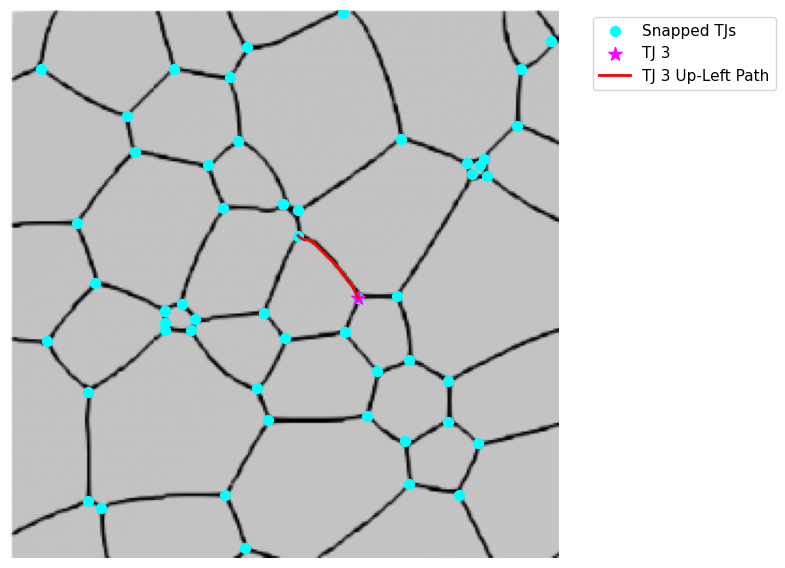

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_3_to_tj_44.png
Path plotted for TJ 3 to TJ 44 (via Up-Left): Reached TJ at 134, 105 in Up-Left (graph distance: 17)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_3_to_tj_4.png


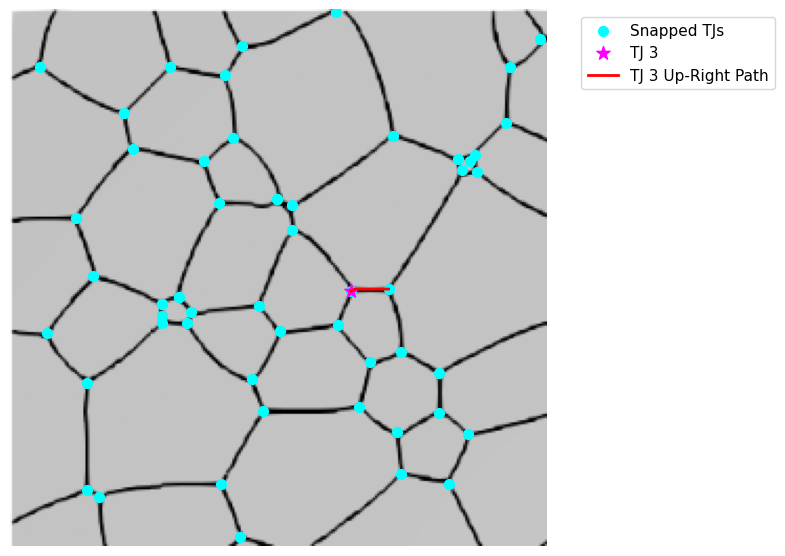

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_3_to_tj_4.png
Path plotted for TJ 3 to TJ 4 (via Up-Right): Reached TJ at 180, 133 in Up-Right (graph distance: 9)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_3_to_tj_5.png


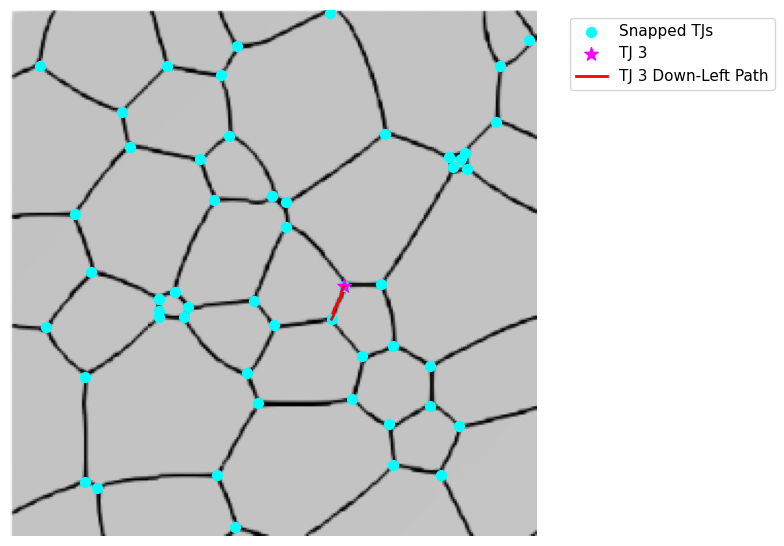

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_3_to_tj_5.png
Path plotted for TJ 3 to TJ 5 (via Down-Left): Reached TJ at 156, 150 in Down-Left (graph distance: 8)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_4_to_tj_42.png


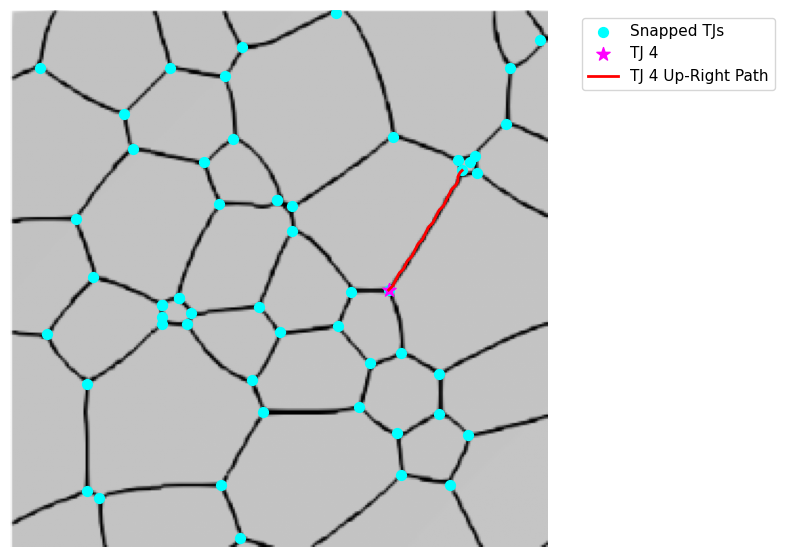

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_4_to_tj_42.png
Path plotted for TJ 4 to TJ 42 (via Up-Right): Reached TJ at 215, 76 in Up-Right (graph distance: 29)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_4_to_tj_17.png


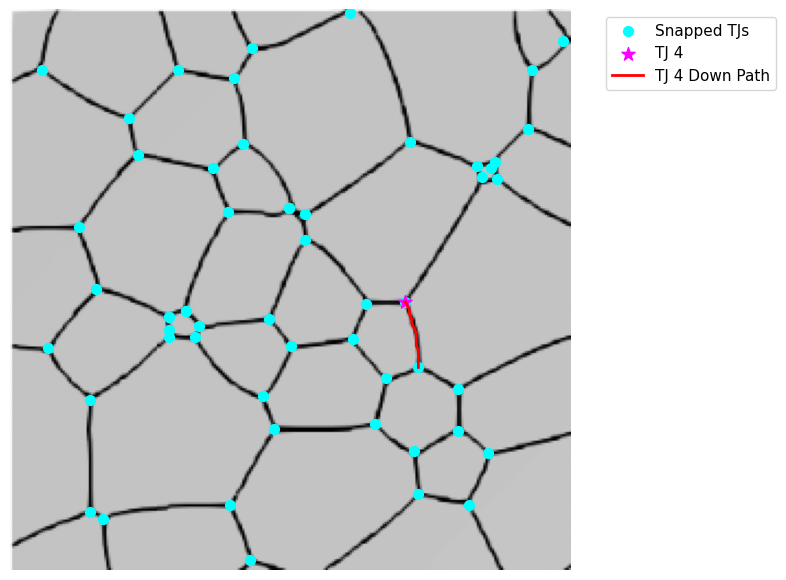

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_4_to_tj_17.png
Path plotted for TJ 4 to TJ 17 (via Down): Reached TJ at 186, 163 in Down (graph distance: 15)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_5_to_tj_43.png


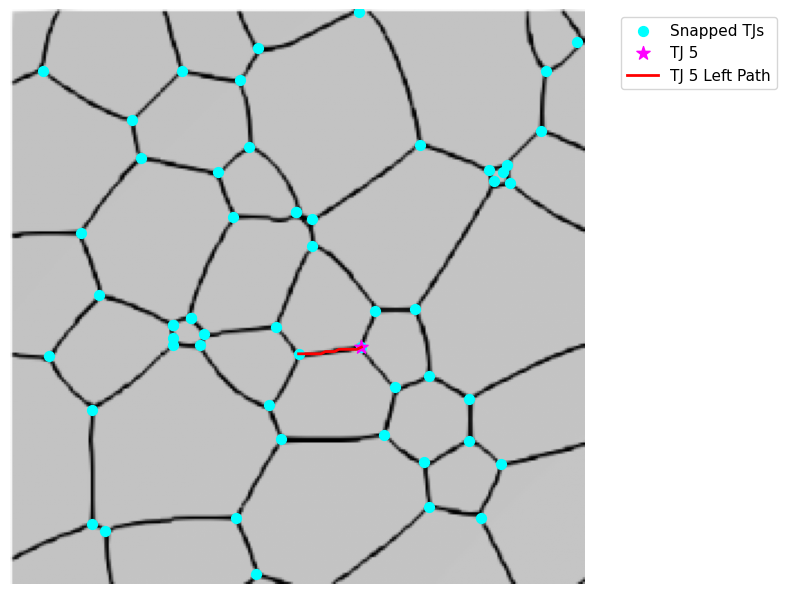

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_5_to_tj_43.png
Path plotted for TJ 5 to TJ 43 (via Left): Reached TJ at 128, 153 in Left (graph distance: 14)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_5_to_tj_15.png


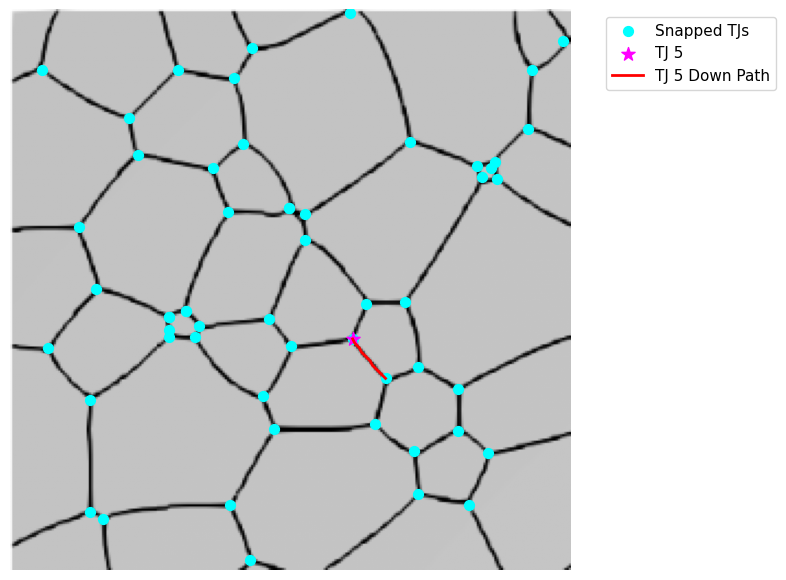

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_5_to_tj_15.png
Path plotted for TJ 5 to TJ 15 (via Down): Reached TJ at 171, 168 in Down (graph distance: 9)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_6_to_tj_36.png


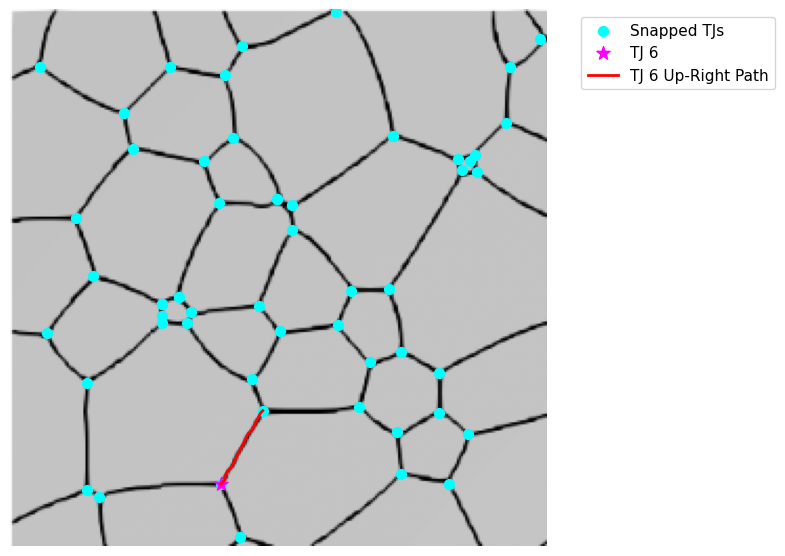

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_6_to_tj_36.png
Path plotted for TJ 6 to TJ 36 (via Up-Right): Reached TJ at 120, 191 in Up-Right (graph distance: 18)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_6_to_tj_45.png


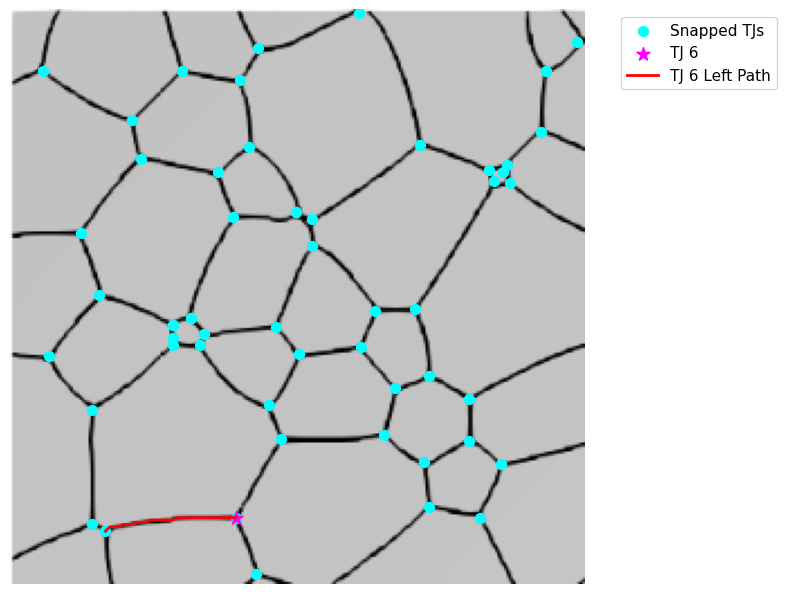

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_6_to_tj_45.png
Path plotted for TJ 6 to TJ 45 (via Left): Reached TJ at 42, 232 in Left (graph distance: 29)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_6_to_tj_9.png


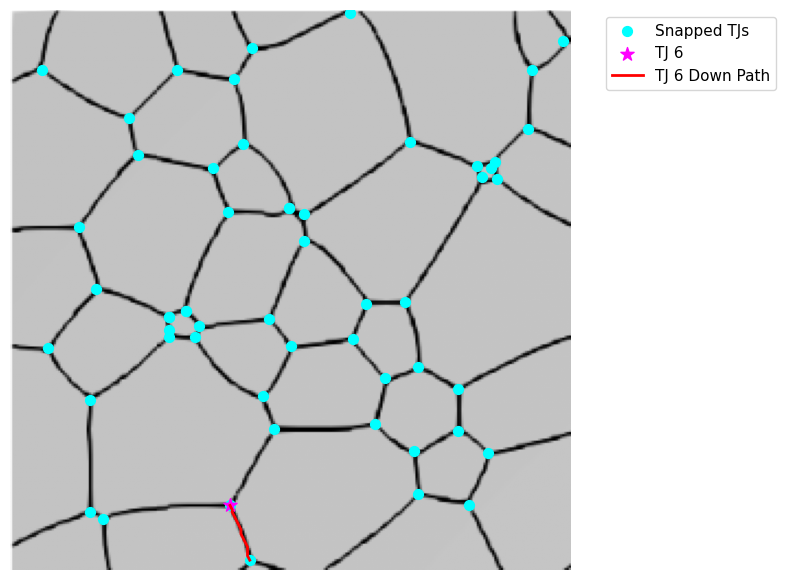

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_6_to_tj_9.png
Path plotted for TJ 6 to TJ 9 (via Down): Reached TJ at 109, 251 in Down (graph distance: 13)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_7_to_tj_49.png


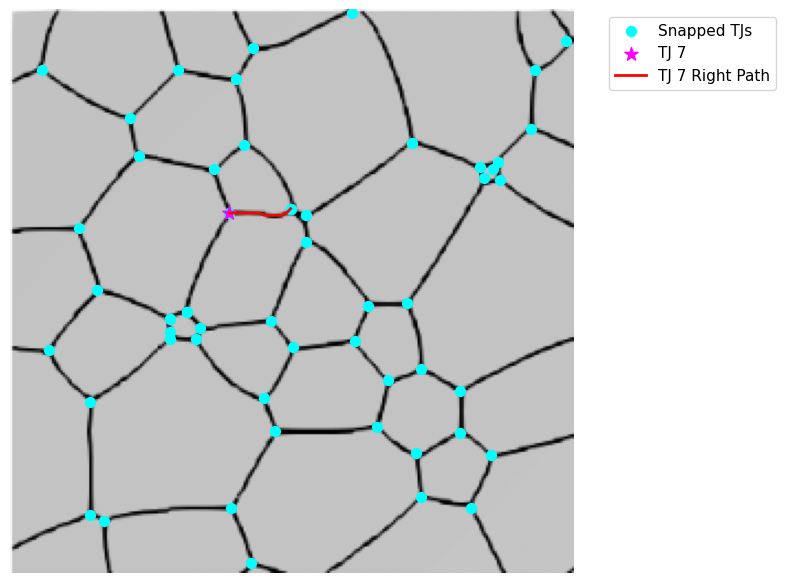

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_7_to_tj_49.png
Path plotted for TJ 7 to TJ 49 (via Right): Reached TJ at 127, 90 in Right (graph distance: 14)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_7_to_tj_29.png


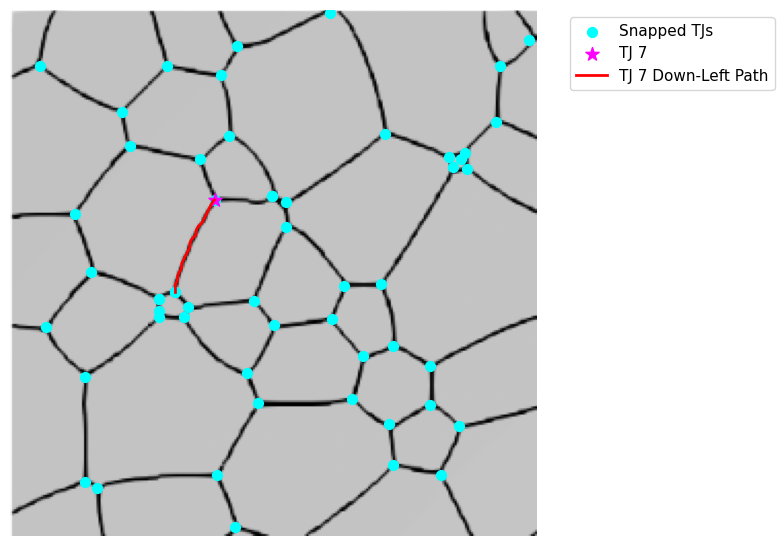

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_7_to_tj_29.png
Path plotted for TJ 7 to TJ 29 (via Down-Left): Reached TJ at 80, 137 in Down-Left (graph distance: 23)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_8_to_tj_26.png


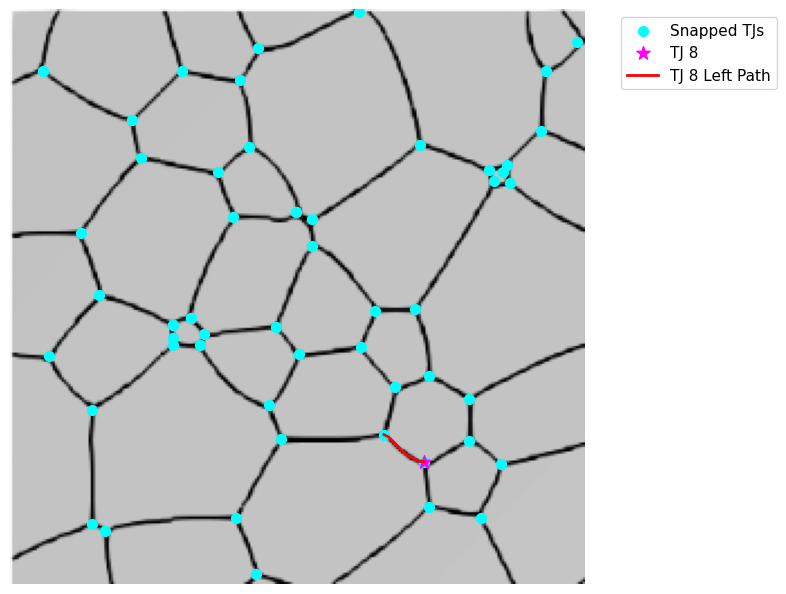

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_8_to_tj_26.png
Path plotted for TJ 8 to TJ 26 (via Left): Reached TJ at 166, 189 in Left (graph distance: 9)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_8_to_tj_34.png


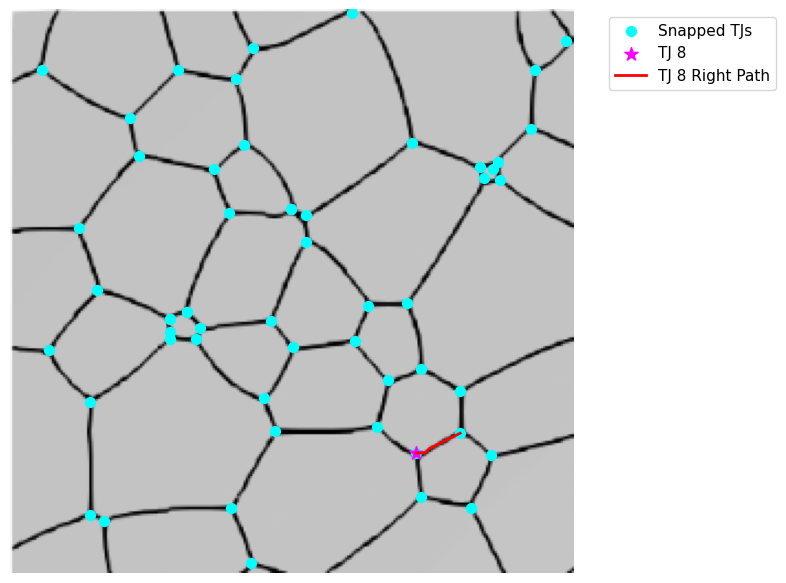

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_8_to_tj_34.png
Path plotted for TJ 8 to TJ 34 (via Right): Reached TJ at 204, 192 in Right (graph distance: 10)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_8_to_tj_18.png


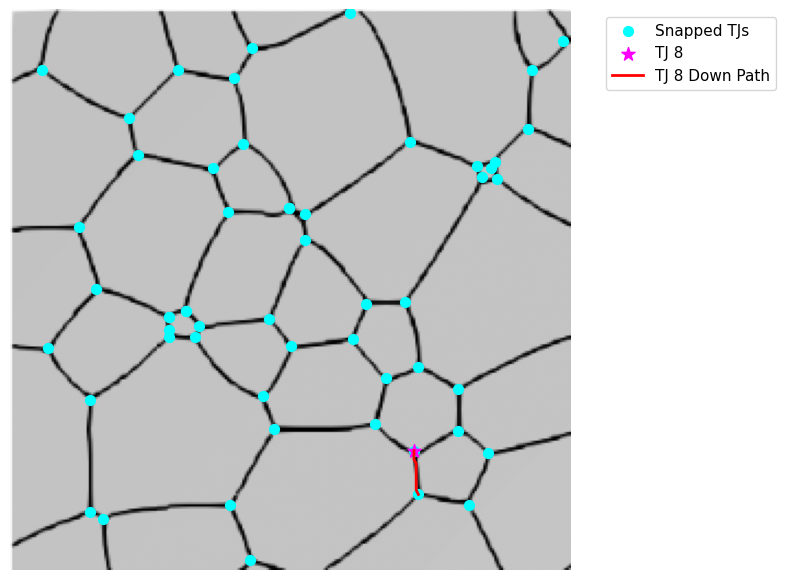

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_8_to_tj_18.png
Path plotted for TJ 8 to TJ 18 (via Down): Reached TJ at 186, 221 in Down (graph distance: 10)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_10_to_tj_24.png


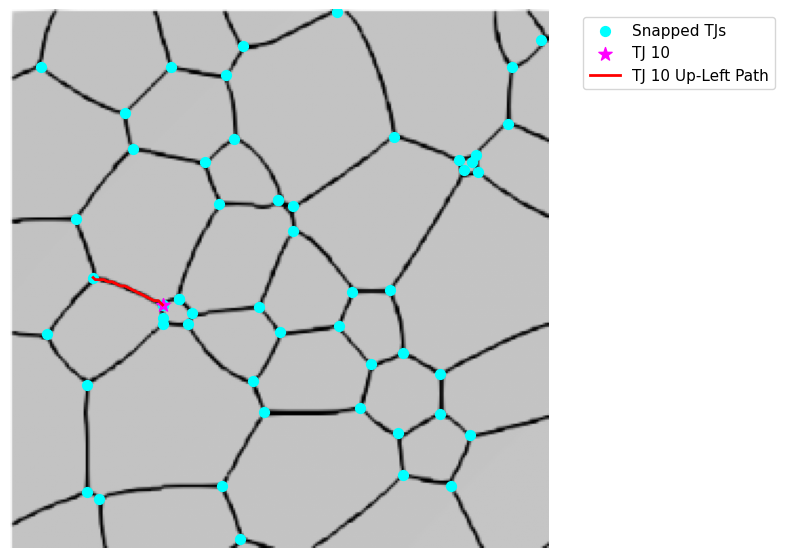

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_10_to_tj_24.png
Path plotted for TJ 10 to TJ 24 (via Up-Left): Reached TJ at 39, 127 in Up-Left (graph distance: 17)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_10_to_tj_29.png


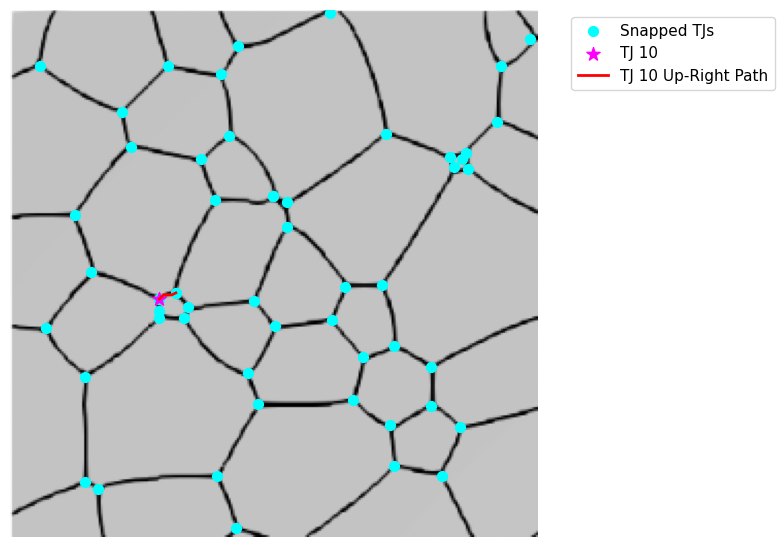

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_10_to_tj_29.png
Path plotted for TJ 10 to TJ 29 (via Up-Right): Reached TJ at 80, 137 in Up-Right (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_10_to_tj_54.png


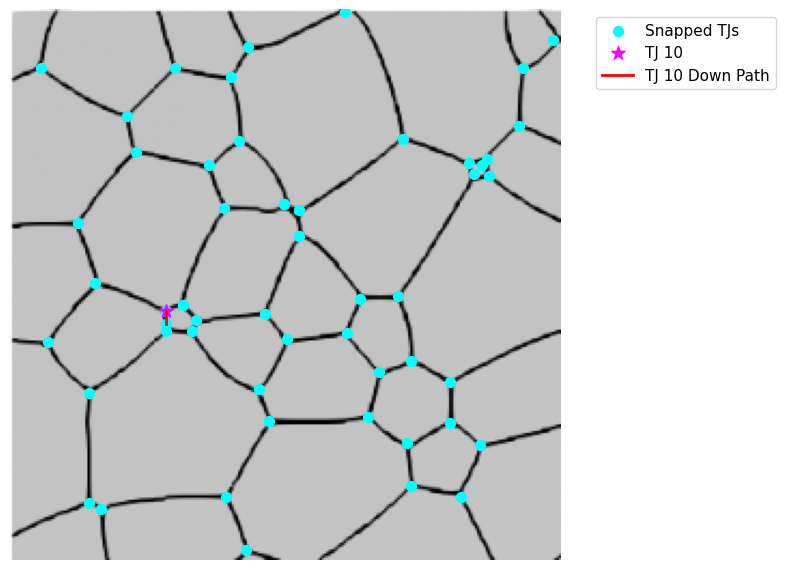

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_10_to_tj_54.png
Path plotted for TJ 10 to TJ 54 (via Down): Reached TJ at 72, 146 in Down (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_11_to_tj_30.png


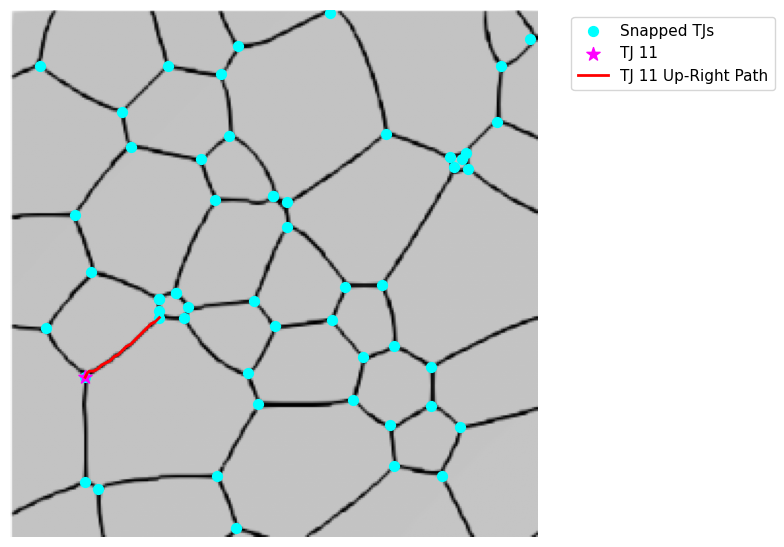

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_11_to_tj_30.png
Path plotted for TJ 11 to TJ 30 (via Up-Right): Reached TJ at 72, 149 in Up-Right (graph distance: 19)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_11_to_tj_40.png


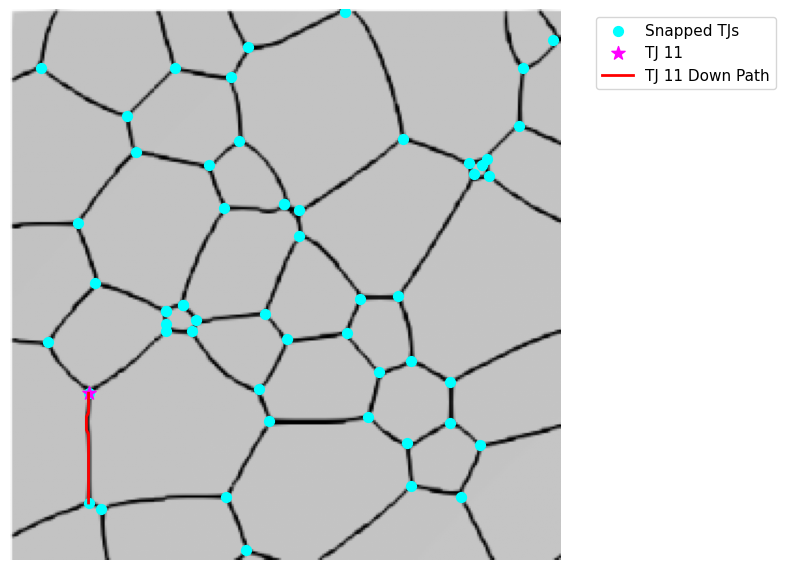

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_11_to_tj_40.png
Path plotted for TJ 11 to TJ 40 (via Down): Reached TJ at 36, 229 in Down (graph distance: 26)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_12_to_tj_23.png


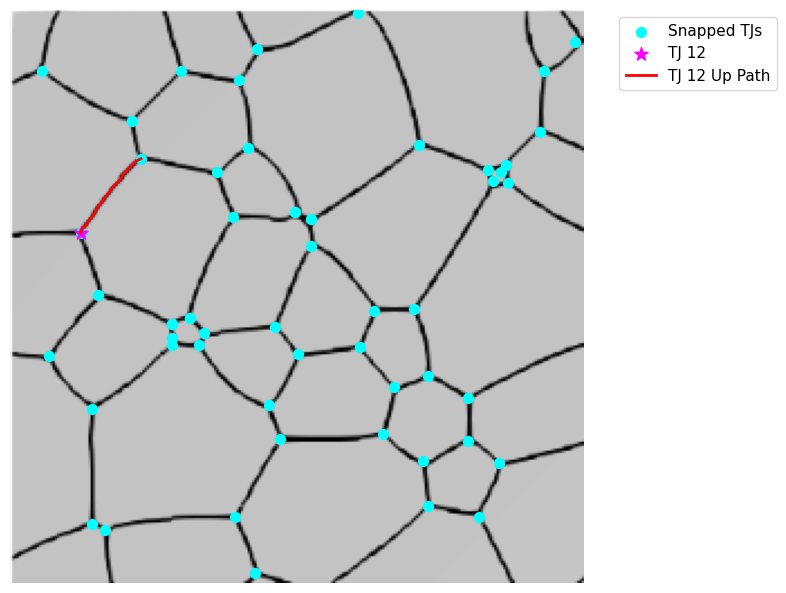

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_12_to_tj_23.png
Path plotted for TJ 12 to TJ 23 (via Up): Reached TJ at 58, 66 in Up (graph distance: 17)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_12_to_tj_24.png


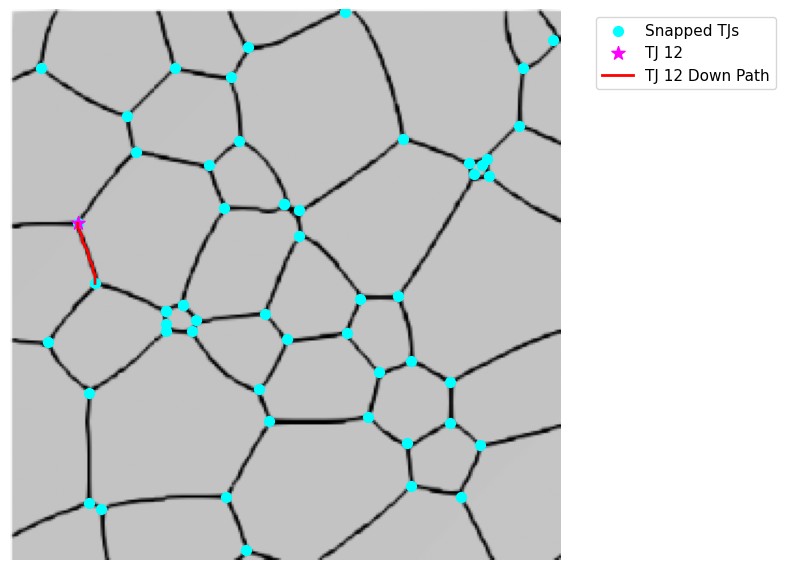

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_12_to_tj_24.png
Path plotted for TJ 12 to TJ 24 (via Down): Reached TJ at 39, 127 in Down (graph distance: 14)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_13_to_tj_48.png


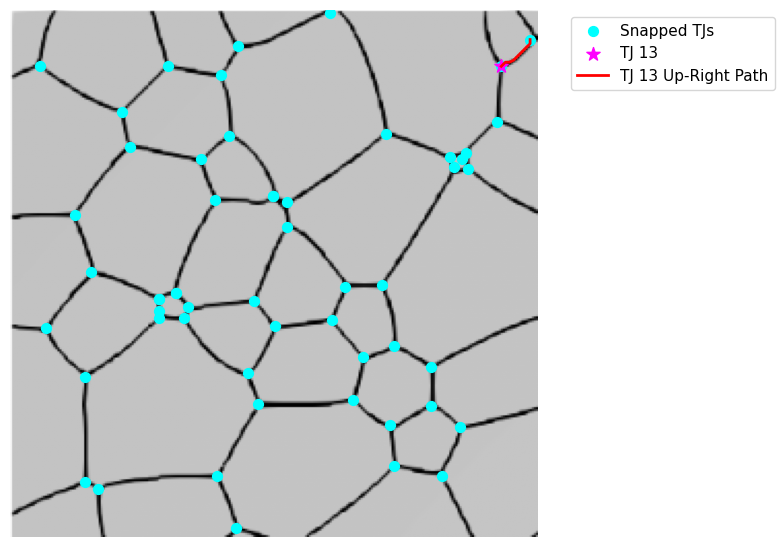

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_13_to_tj_48.png
Path plotted for TJ 13 to TJ 48 (via Up-Right): Reached TJ at 252, 14 in Up-Right (graph distance: 8)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_13_to_tj_33.png


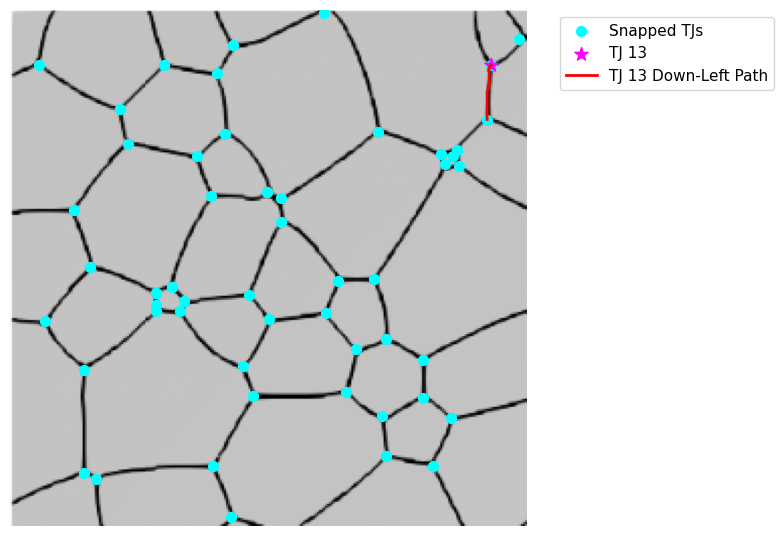

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_13_to_tj_33.png
Path plotted for TJ 13 to TJ 33 (via Down-Left): Reached TJ at 236, 54 in Down-Left (graph distance: 14)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_14_to_tj_52.png


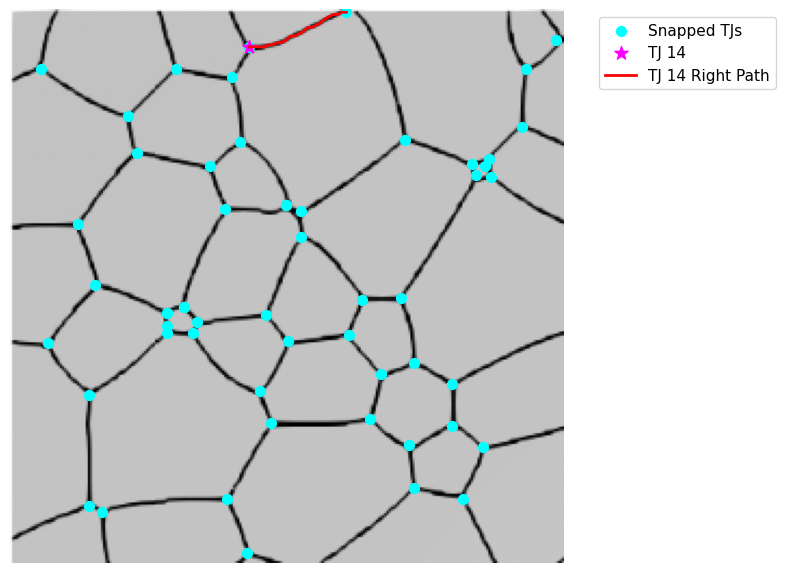

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_14_to_tj_52.png
Path plotted for TJ 14 to TJ 52 (via Right): Reached TJ at 155, 1 in Right (graph distance: 23)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_14_to_tj_32.png


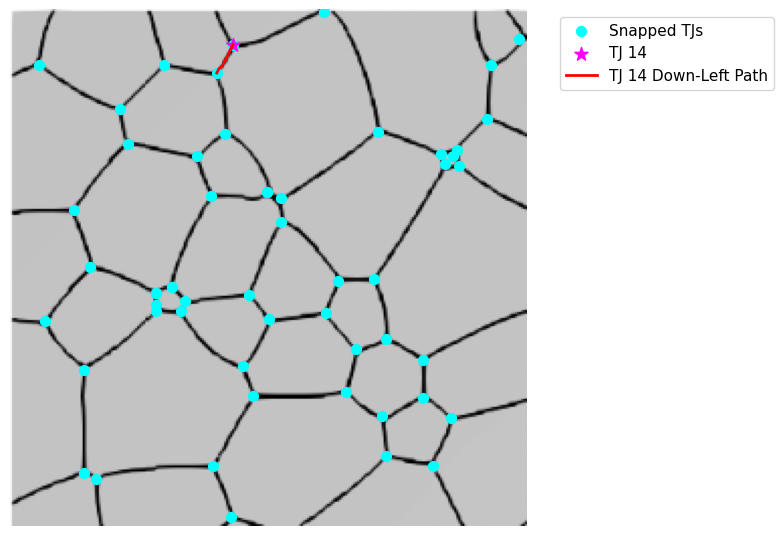

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_14_to_tj_32.png
Path plotted for TJ 14 to TJ 32 (via Down-Left): Reached TJ at 102, 31 in Down-Left (graph distance: 7)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_15_to_tj_17.png


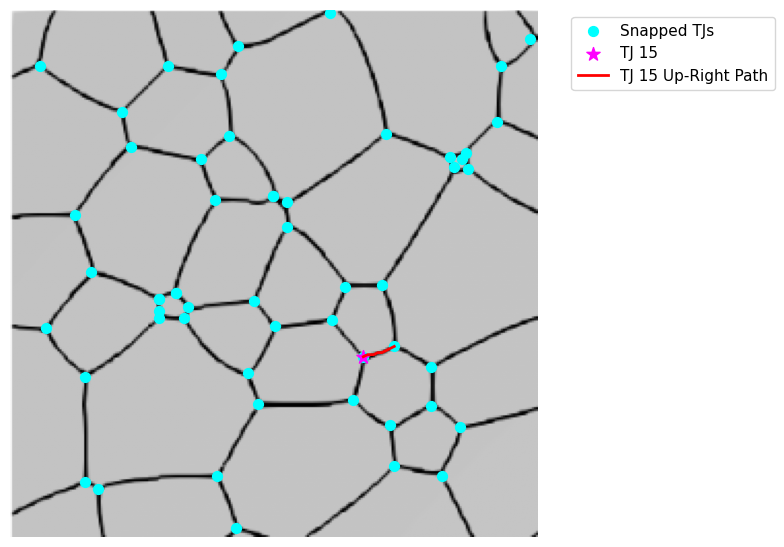

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_15_to_tj_17.png
Path plotted for TJ 15 to TJ 17 (via Up-Right): Reached TJ at 186, 163 in Up-Right (graph distance: 8)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_15_to_tj_26.png


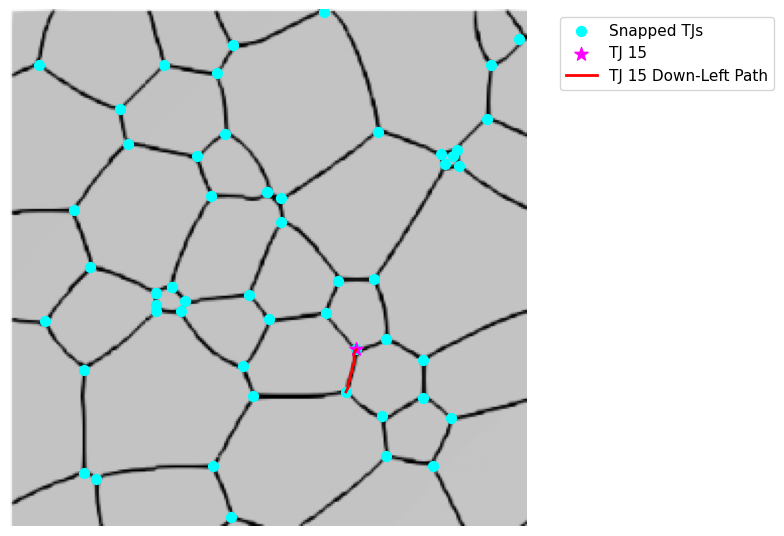

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_15_to_tj_26.png
Path plotted for TJ 15 to TJ 26 (via Down-Left): Reached TJ at 166, 189 in Down-Left (graph distance: 11)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_16_to_tj_34.png


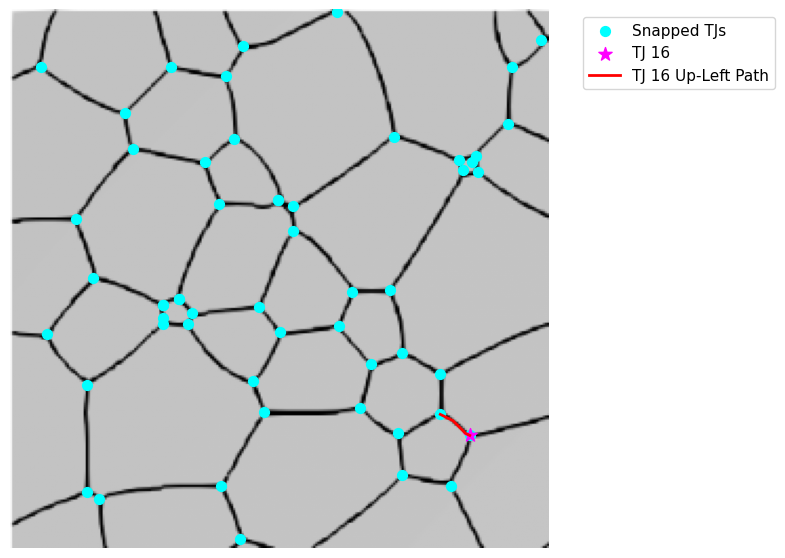

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_16_to_tj_34.png
Path plotted for TJ 16 to TJ 34 (via Up-Left): Reached TJ at 204, 192 in Up-Left (graph distance: 7)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_16_to_tj_38.png


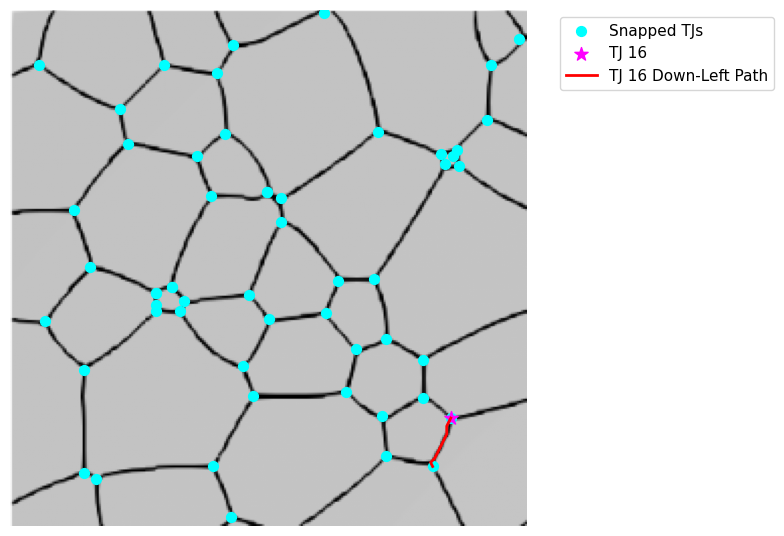

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_16_to_tj_38.png
Path plotted for TJ 16 to TJ 38 (via Down-Left): Reached TJ at 209, 226 in Down-Left (graph distance: 12)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_17_to_tj_47.png


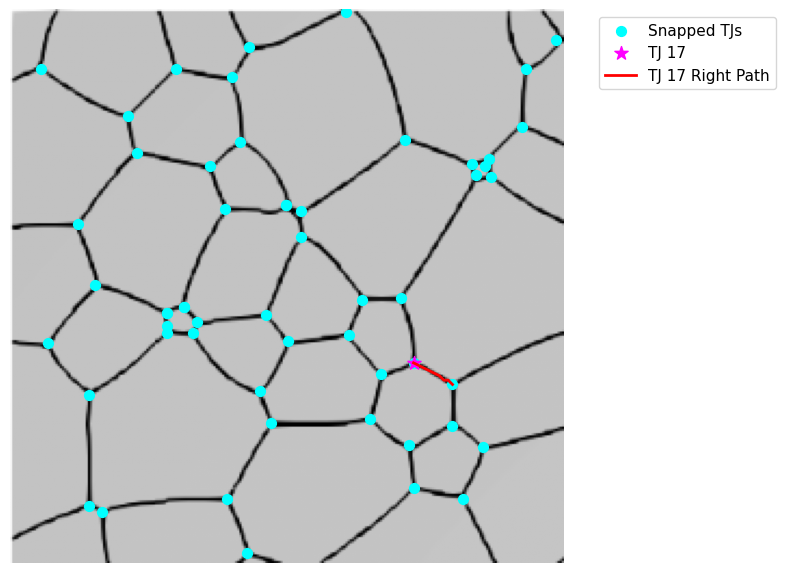

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_17_to_tj_47.png
Path plotted for TJ 17 to TJ 47 (via Right): Reached TJ at 204, 173 in Right (graph distance: 9)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_18_to_tj_38.png


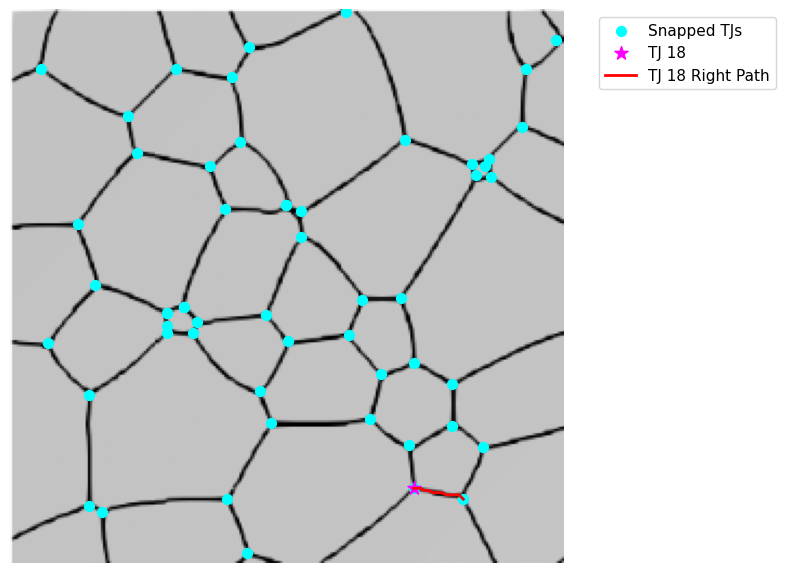

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_18_to_tj_38.png
Path plotted for TJ 18 to TJ 38 (via Right): Reached TJ at 209, 226 in Right (graph distance: 12)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_19_to_tj_24.png


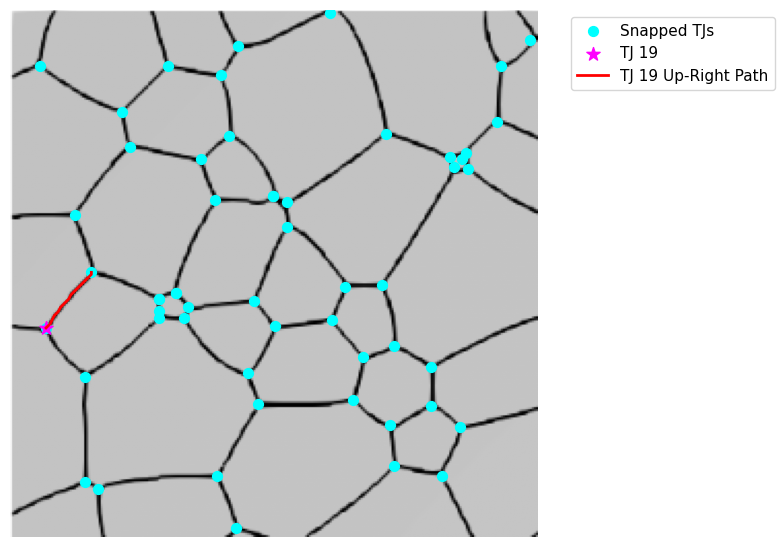

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_19_to_tj_24.png
Path plotted for TJ 19 to TJ 24 (via Up-Right): Reached TJ at 39, 127 in Up-Right (graph distance: 14)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_19_to_tj_11.png


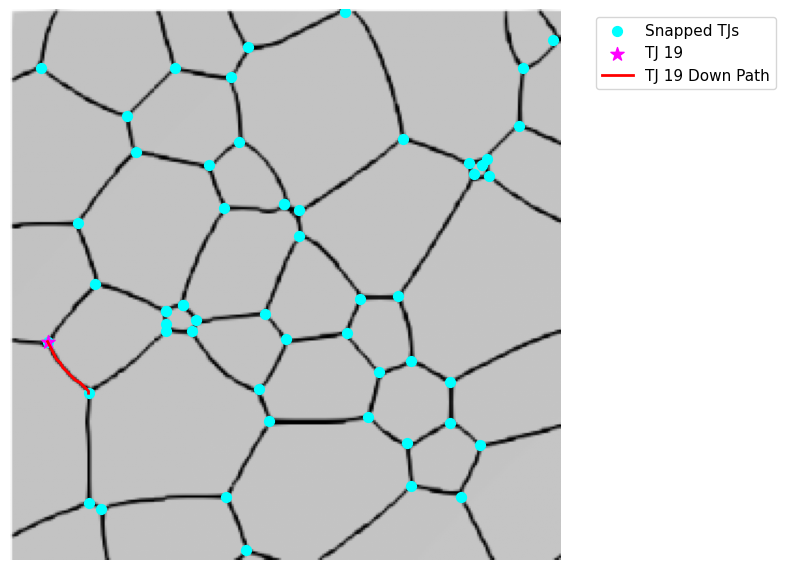

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_19_to_tj_11.png
Path plotted for TJ 19 to TJ 11 (via Down): Reached TJ at 36, 178 in Down (graph distance: 13)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_20_to_tj_32.png


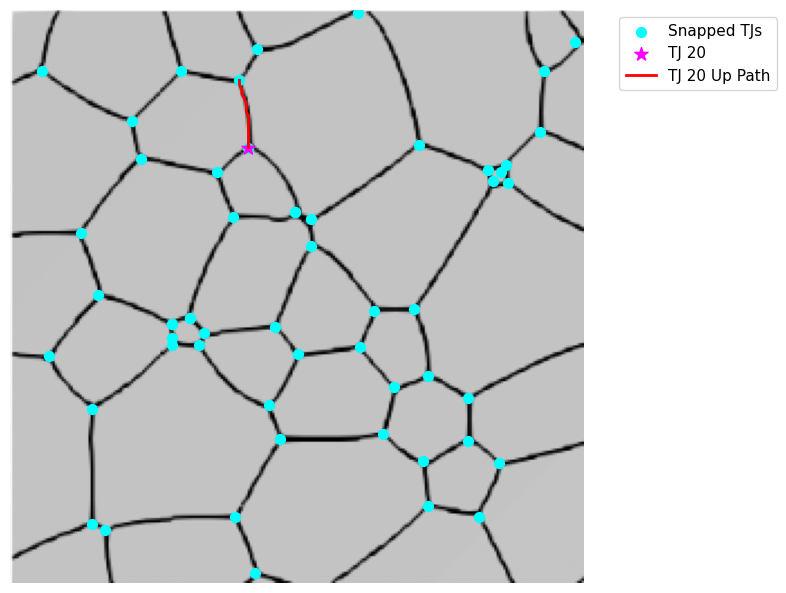

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_20_to_tj_32.png
Path plotted for TJ 20 to TJ 32 (via Up): Reached TJ at 102, 31 in Up (graph distance: 15)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_20_to_tj_49.png


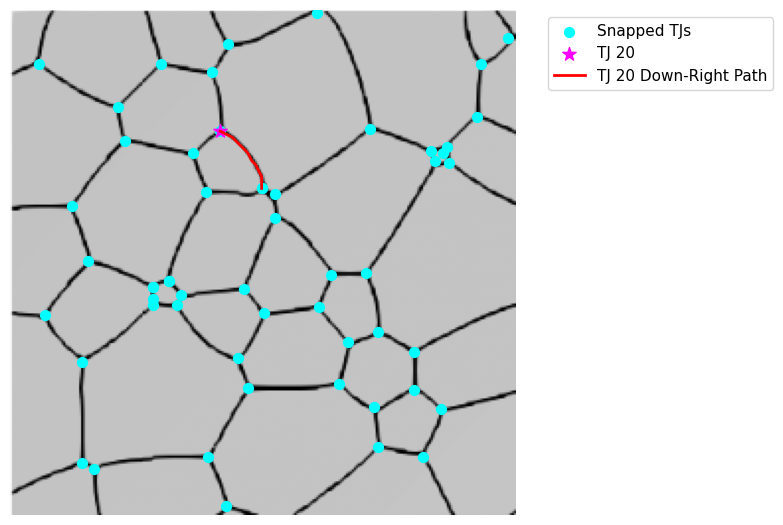

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_20_to_tj_49.png
Path plotted for TJ 20 to TJ 49 (via Down-Right): Reached TJ at 127, 90 in Down-Right (graph distance: 16)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_21_to_tj_53.png


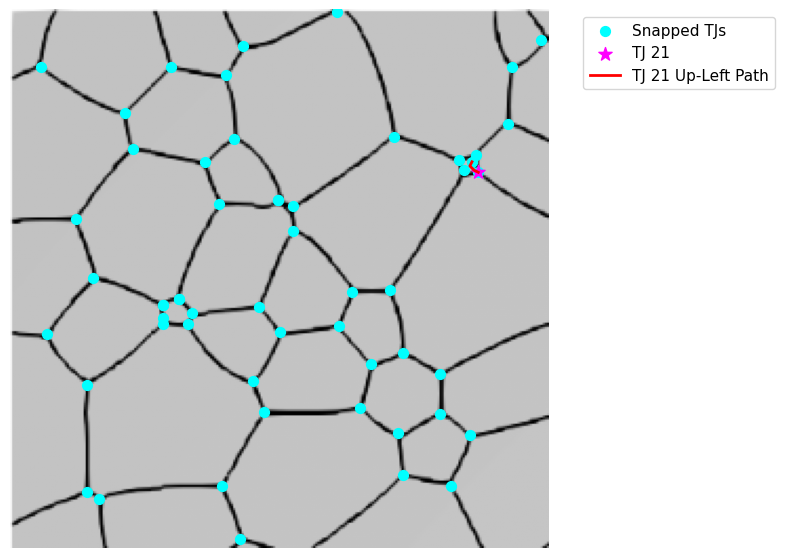

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_21_to_tj_53.png
Path plotted for TJ 21 to TJ 53 (via Up-Left): Reached TJ at 219, 72 in Up-Left (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_21_to_tj_42.png


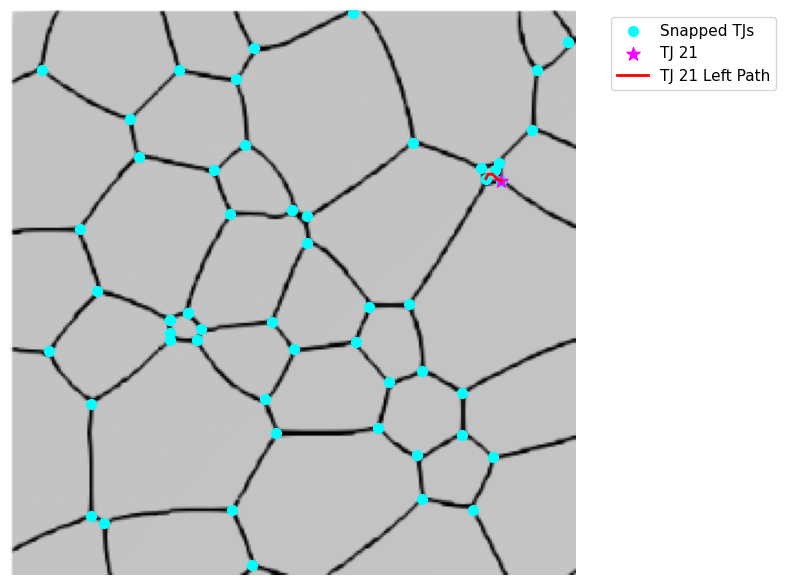

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_21_to_tj_42.png
Path plotted for TJ 21 to TJ 42 (via Left): Reached TJ at 215, 76 in Left (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_22_to_tj_53.png


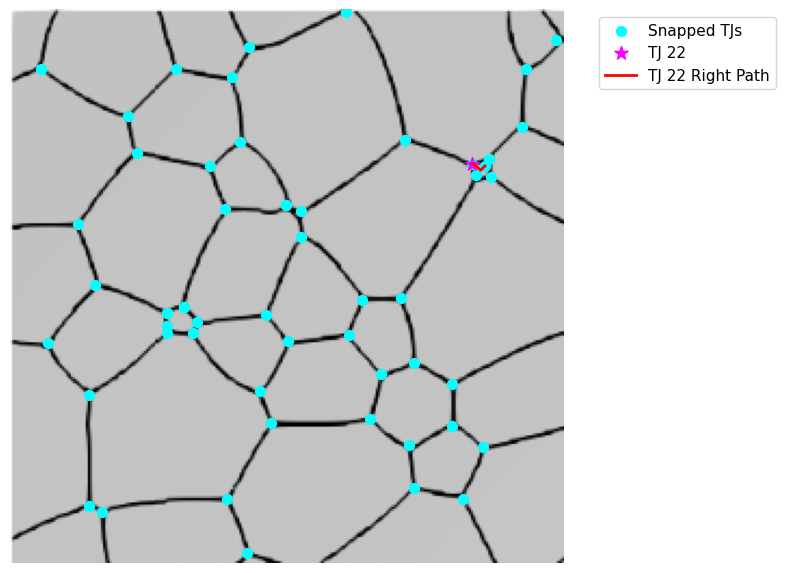

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_22_to_tj_53.png
Path plotted for TJ 22 to TJ 53 (via Right): Reached TJ at 219, 72 in Right (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_22_to_tj_42.png


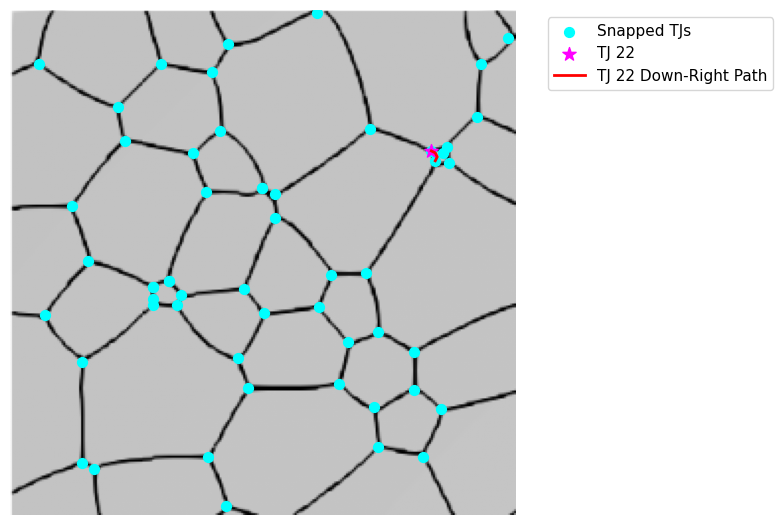

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_22_to_tj_42.png
Path plotted for TJ 22 to TJ 42 (via Down-Right): Reached TJ at 215, 76 in Down-Right (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_23_to_tj_31.png


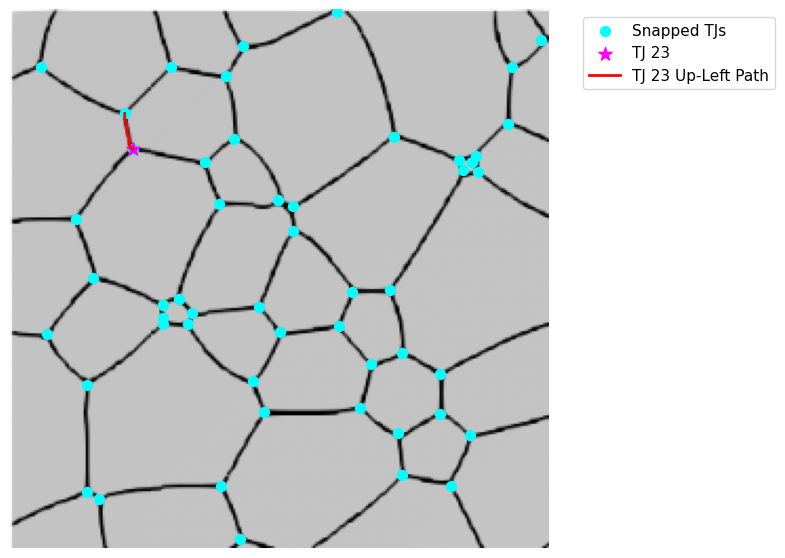

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_23_to_tj_31.png
Path plotted for TJ 23 to TJ 31 (via Up-Left): Reached TJ at 54, 49 in Up-Left (graph distance: 9)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_25_to_tj_31.png


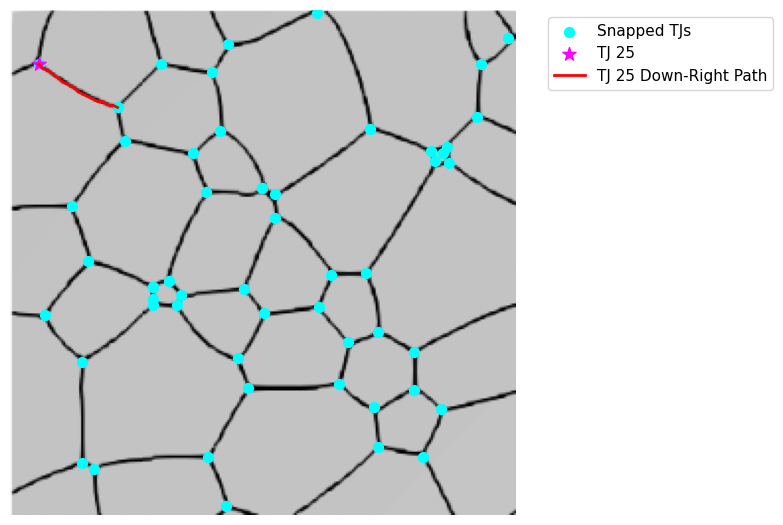

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_25_to_tj_31.png
Path plotted for TJ 25 to TJ 31 (via Down-Right): Reached TJ at 54, 49 in Down-Right (graph distance: 20)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_26_to_tj_36.png


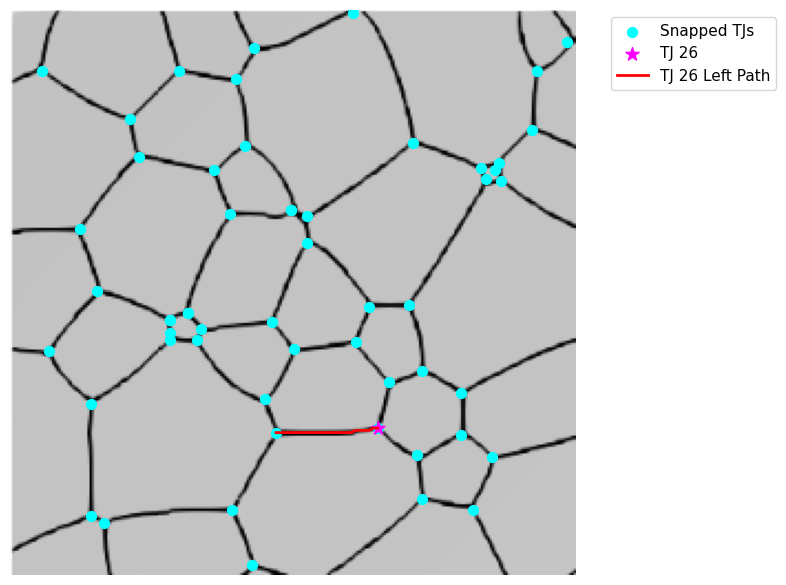

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_26_to_tj_36.png
Path plotted for TJ 26 to TJ 36 (via Left): Reached TJ at 120, 191 in Left (graph distance: 23)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_27_to_tj_32.png


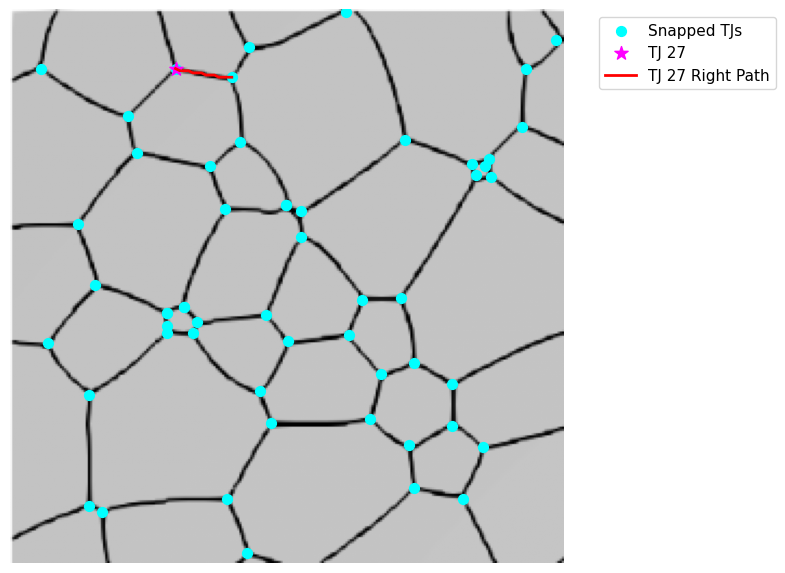

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_27_to_tj_32.png
Path plotted for TJ 27 to TJ 32 (via Right): Reached TJ at 102, 31 in Right (graph distance: 13)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_27_to_tj_31.png


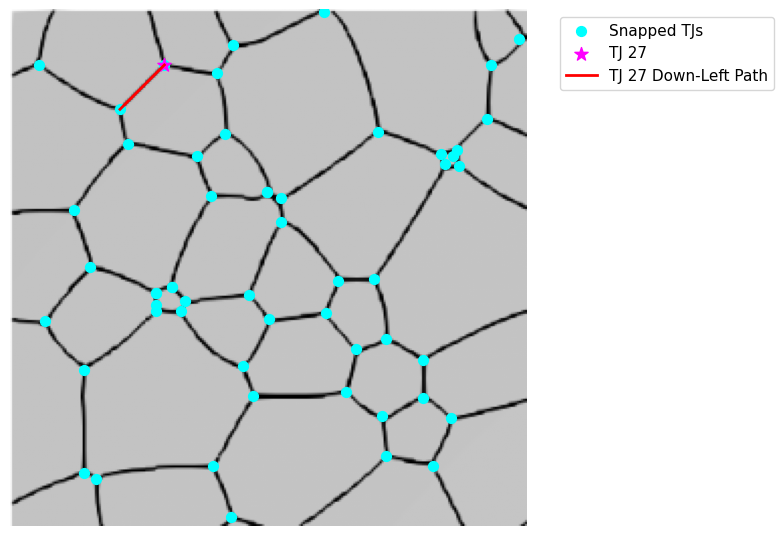

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_27_to_tj_31.png
Path plotted for TJ 27 to TJ 31 (via Down-Left): Reached TJ at 54, 49 in Down-Left (graph distance: 11)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_28_to_tj_46.png


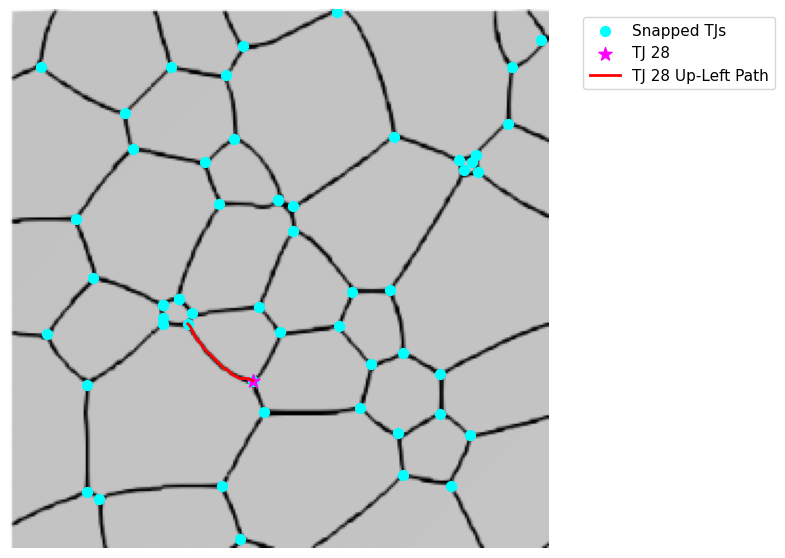

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_28_to_tj_46.png
Path plotted for TJ 28 to TJ 46 (via Up-Left): Reached TJ at 84, 149 in Up-Left (graph distance: 18)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_28_to_tj_43.png


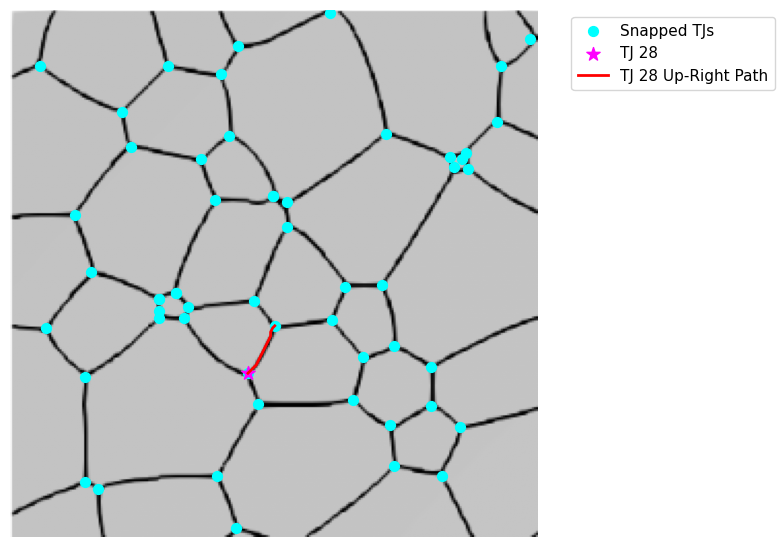

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_28_to_tj_43.png
Path plotted for TJ 28 to TJ 43 (via Up-Right): Reached TJ at 128, 153 in Up-Right (graph distance: 12)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_28_to_tj_36.png


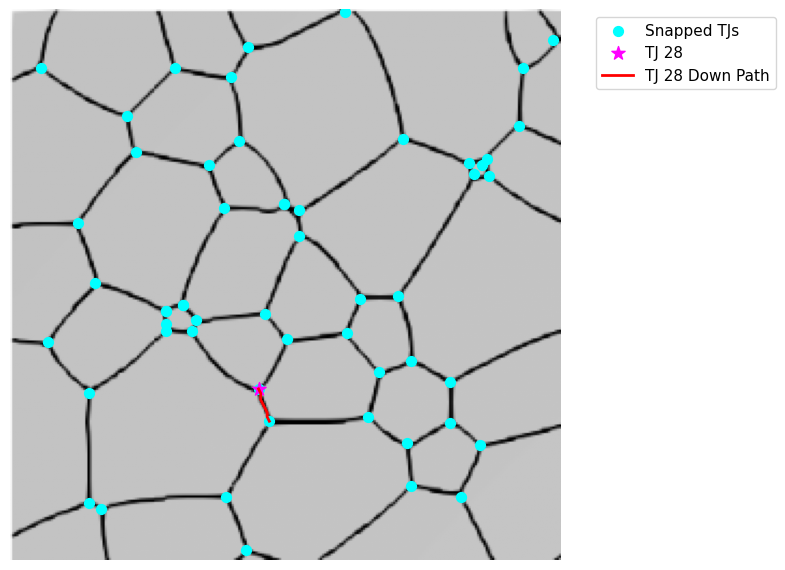

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_28_to_tj_36.png
Path plotted for TJ 28 to TJ 36 (via Down): Reached TJ at 120, 191 in Down (graph distance: 8)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_29_to_tj_37.png


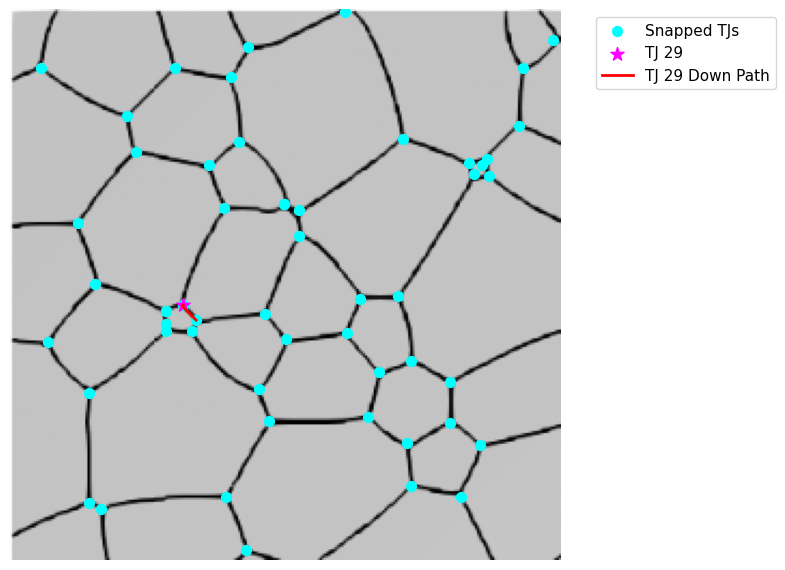

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_29_to_tj_37.png
Path plotted for TJ 29 to TJ 37 (via Down): Reached TJ at 86, 144 in Down (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_30_to_tj_54.png


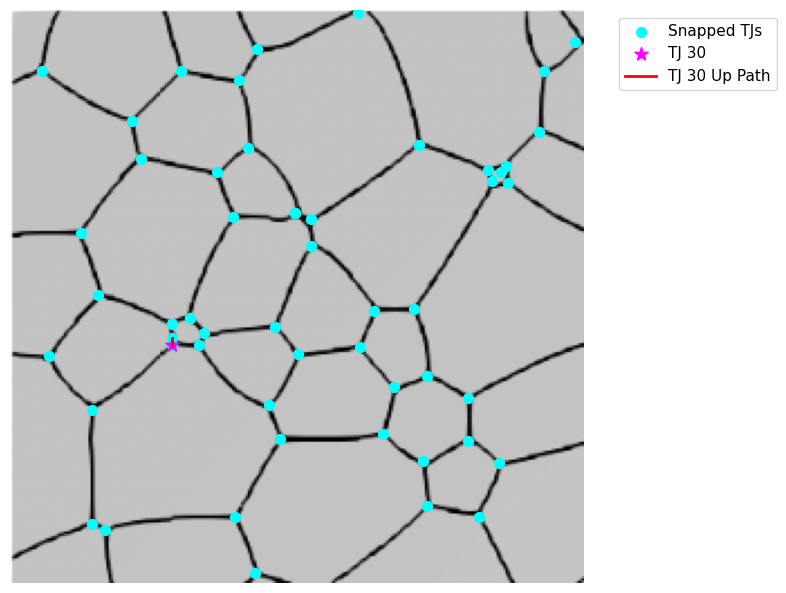

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_30_to_tj_54.png
Path plotted for TJ 30 to TJ 54 (via Up): Reached TJ at 72, 146 in Up (graph distance: 2)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_30_to_tj_46.png


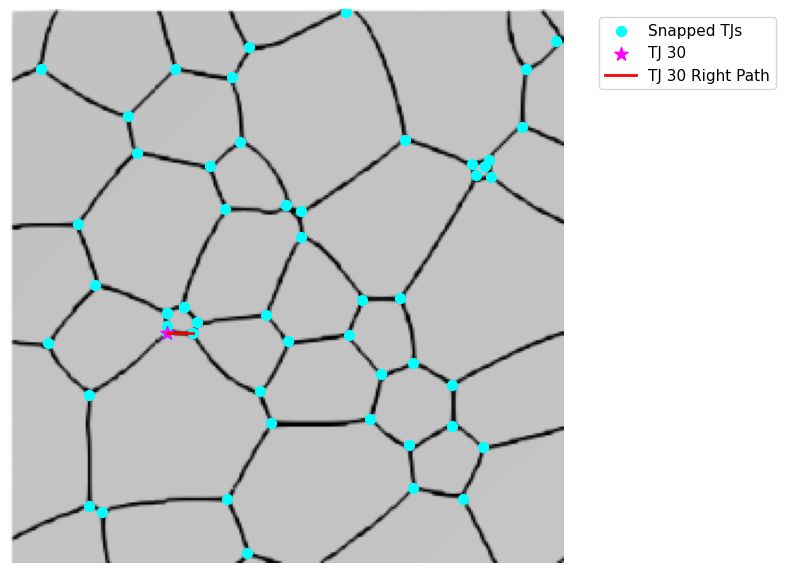

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_30_to_tj_46.png
Path plotted for TJ 30 to TJ 46 (via Right): Reached TJ at 84, 149 in Right (graph distance: 6)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_33_to_tj_39.png


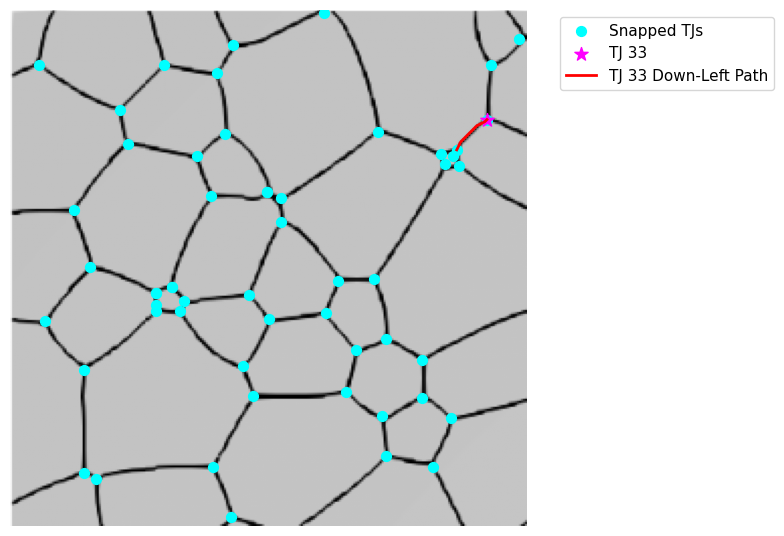

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_33_to_tj_39.png
Path plotted for TJ 33 to TJ 39 (via Down-Left): Reached TJ at 221, 69 in Down-Left (graph distance: 9)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_34_to_tj_47.png


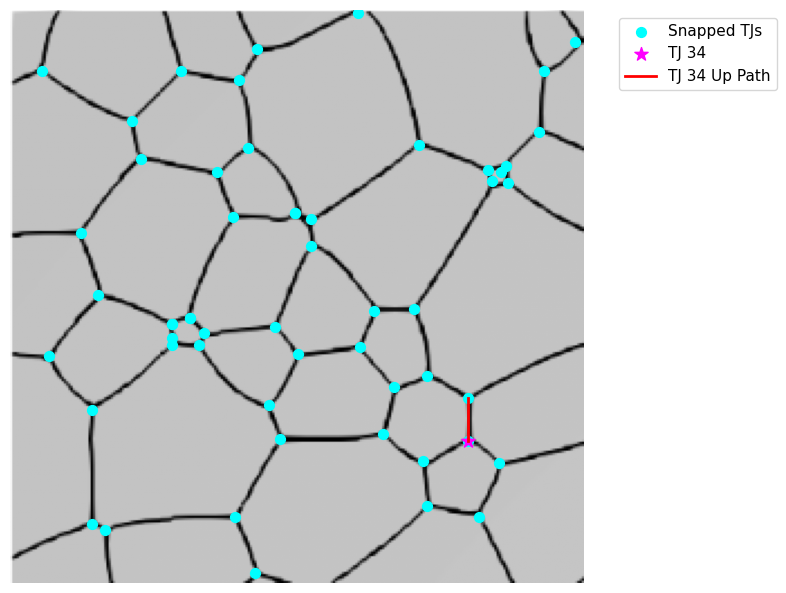

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_34_to_tj_47.png
Path plotted for TJ 34 to TJ 47 (via Up): Reached TJ at 204, 173 in Up (graph distance: 10)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_35_to_tj_49.png


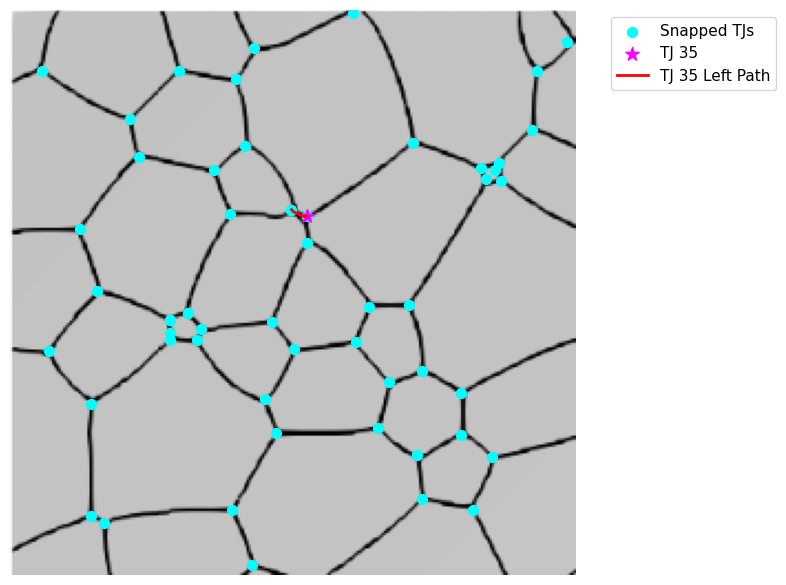

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_35_to_tj_49.png
Path plotted for TJ 35 to TJ 49 (via Left): Reached TJ at 127, 90 in Left (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_35_to_tj_44.png


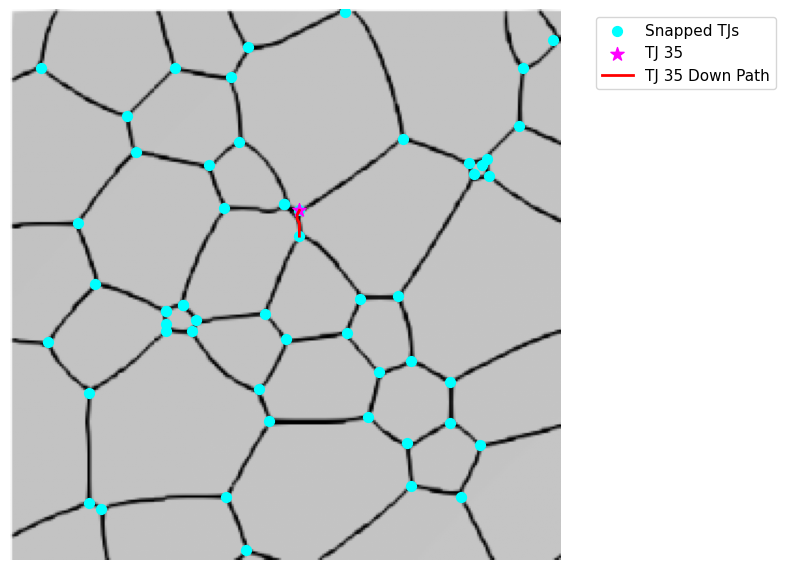

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_35_to_tj_44.png
Path plotted for TJ 35 to TJ 44 (via Down): Reached TJ at 134, 105 in Down (graph distance: 6)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_37_to_tj_41.png


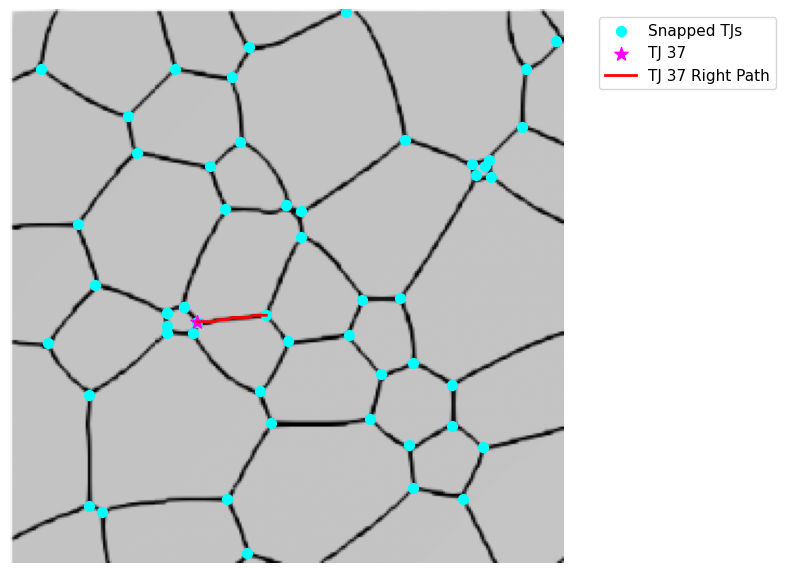

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_37_to_tj_41.png
Path plotted for TJ 37 to TJ 41 (via Right): Reached TJ at 118, 141 in Right (graph distance: 16)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_37_to_tj_46.png


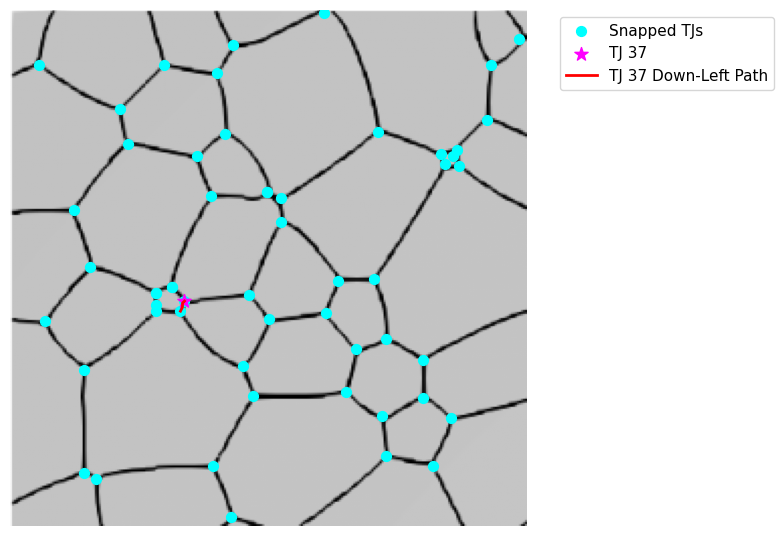

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_37_to_tj_46.png
Path plotted for TJ 37 to TJ 46 (via Down-Left): Reached TJ at 84, 149 in Down-Left (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_39_to_tj_53.png


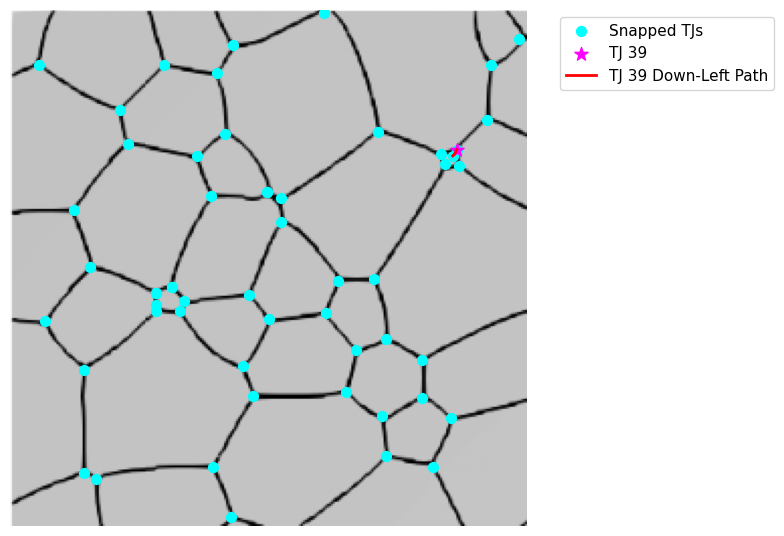

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_39_to_tj_53.png
Path plotted for TJ 39 to TJ 53 (via Down-Left): Reached TJ at 219, 72 in Down-Left (graph distance: 2)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_40_to_tj_45.png


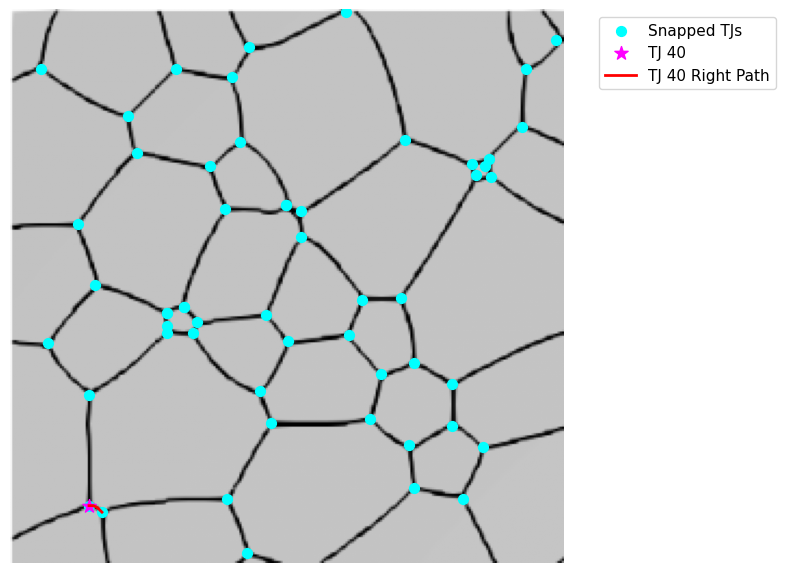

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_40_to_tj_45.png
Path plotted for TJ 40 to TJ 45 (via Right): Reached TJ at 42, 232 in Right (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_41_to_tj_44.png


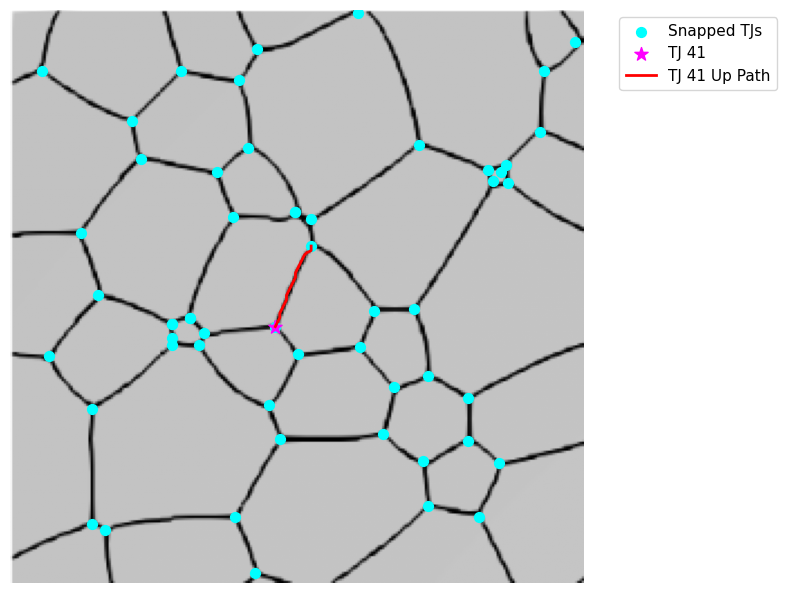

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_41_to_tj_44.png
Path plotted for TJ 41 to TJ 44 (via Up): Reached TJ at 134, 105 in Up (graph distance: 19)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_41_to_tj_43.png


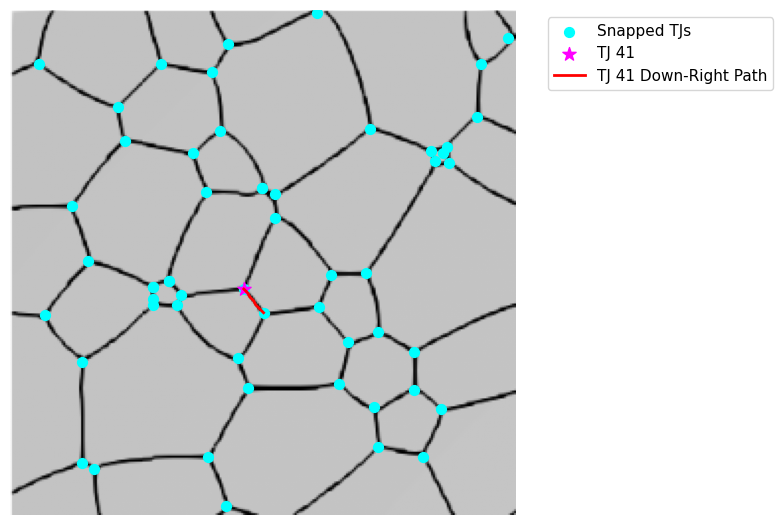

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_41_to_tj_43.png
Path plotted for TJ 41 to TJ 43 (via Down-Right): Reached TJ at 128, 153 in Down-Right (graph distance: 6)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_42_to_tj_53.png


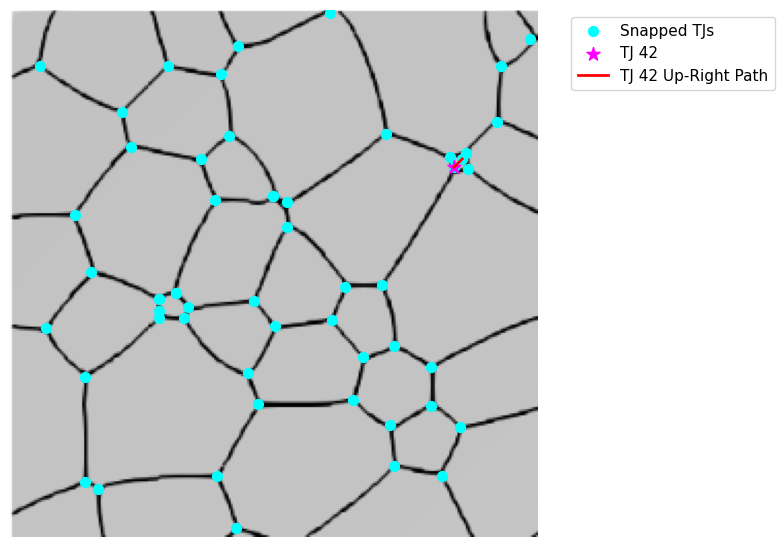

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_42_to_tj_53.png
Path plotted for TJ 42 to TJ 53 (via Up-Right): Reached TJ at 219, 72 in Up-Right (graph distance: 2)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_50_to_tj_24.png


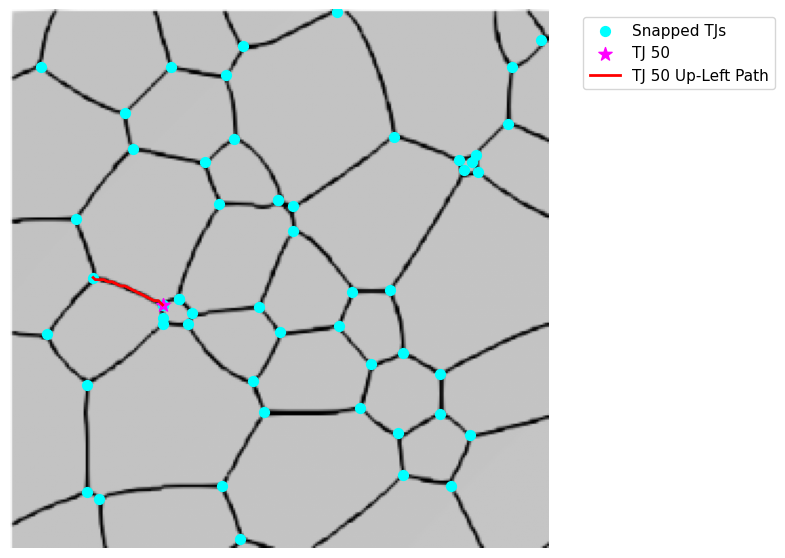

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_50_to_tj_24.png
Path plotted for TJ 50 to TJ 24 (via Up-Left): Reached TJ at 39, 127 in Up-Left (graph distance: 17)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_50_to_tj_29.png


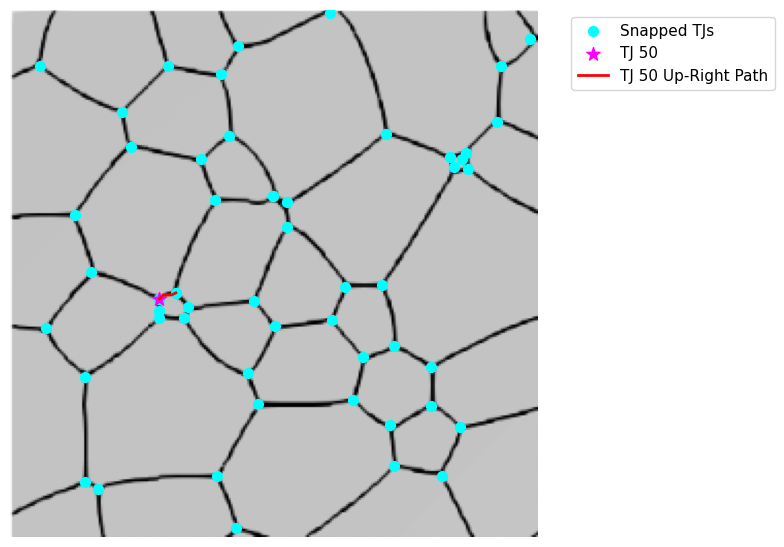

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_50_to_tj_29.png
Path plotted for TJ 50 to TJ 29 (via Up-Right): Reached TJ at 80, 137 in Up-Right (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_50_to_tj_54.png


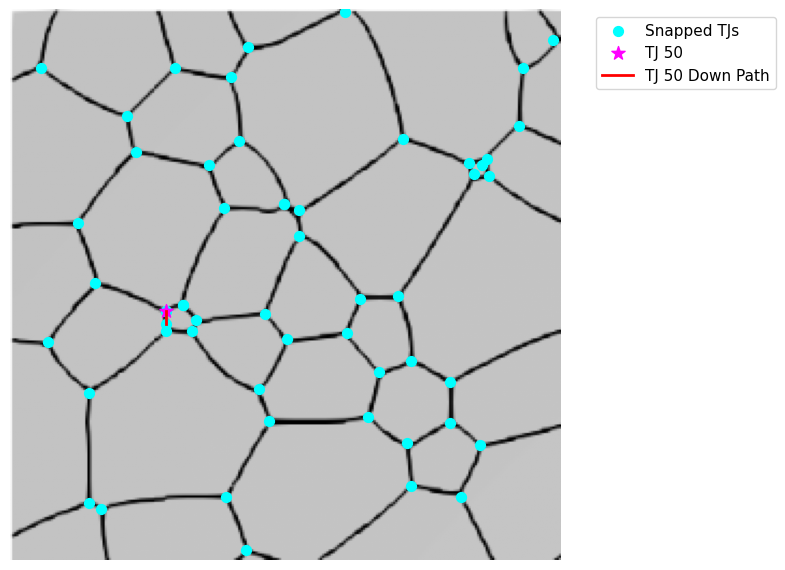

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_50_to_tj_54.png
Path plotted for TJ 50 to TJ 54 (via Down): Reached TJ at 72, 146 in Down (graph distance: 3)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_51_to_tj_20.png


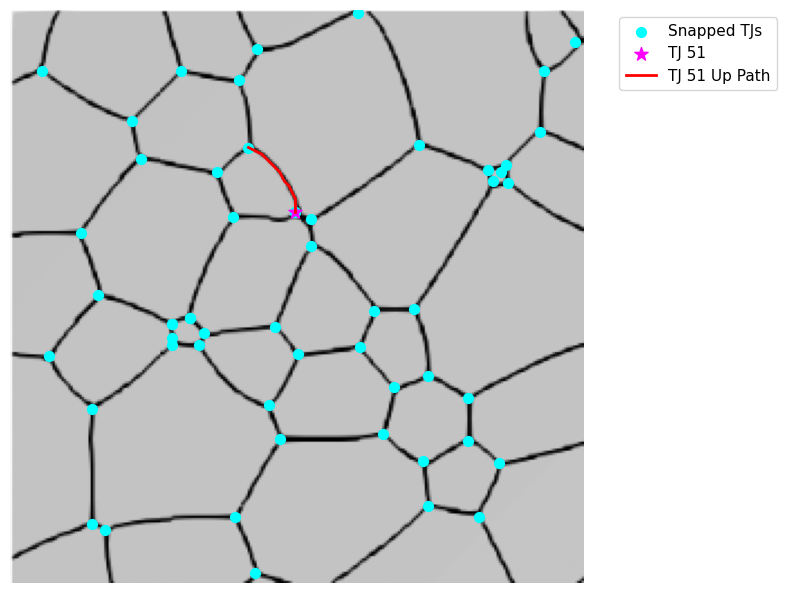

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_51_to_tj_20.png
Path plotted for TJ 51 to TJ 20 (via Up): Reached TJ at 106, 61 in Up (graph distance: 16)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_51_to_tj_7.png


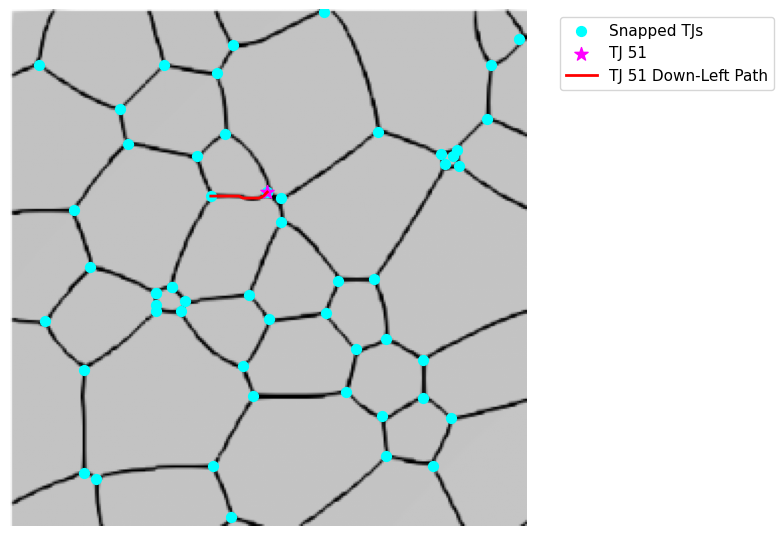

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_51_to_tj_7.png
Path plotted for TJ 51 to TJ 7 (via Down-Left): Reached TJ at 99, 92 in Down-Left (graph distance: 14)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_51_to_tj_35.png


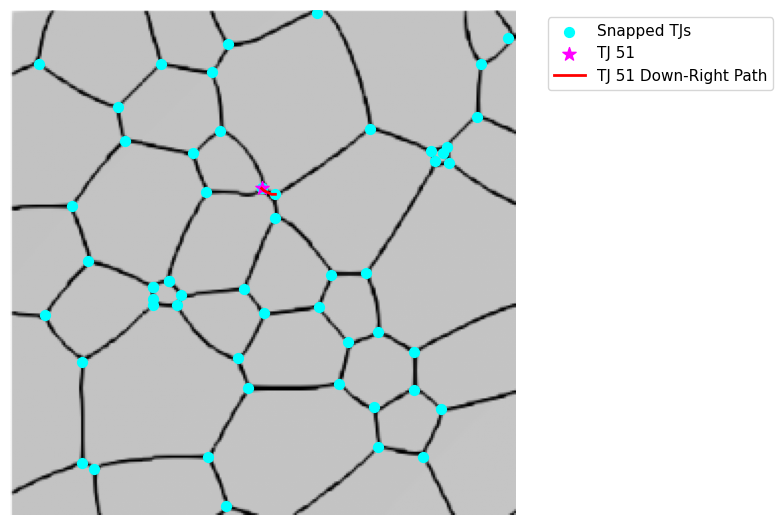

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_51_to_tj_35.png
Path plotted for TJ 51 to TJ 35 (via Down-Right): Reached TJ at 134, 93 in Down-Right (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_55_to_tj_7.png


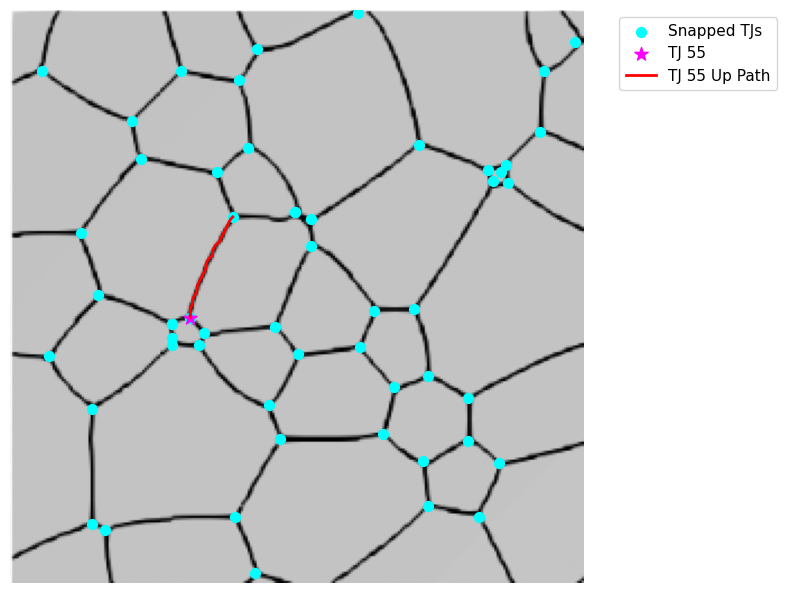

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_55_to_tj_7.png
Path plotted for TJ 55 to TJ 7 (via Up): Reached TJ at 99, 92 in Up (graph distance: 23)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_55_to_tj_10.png


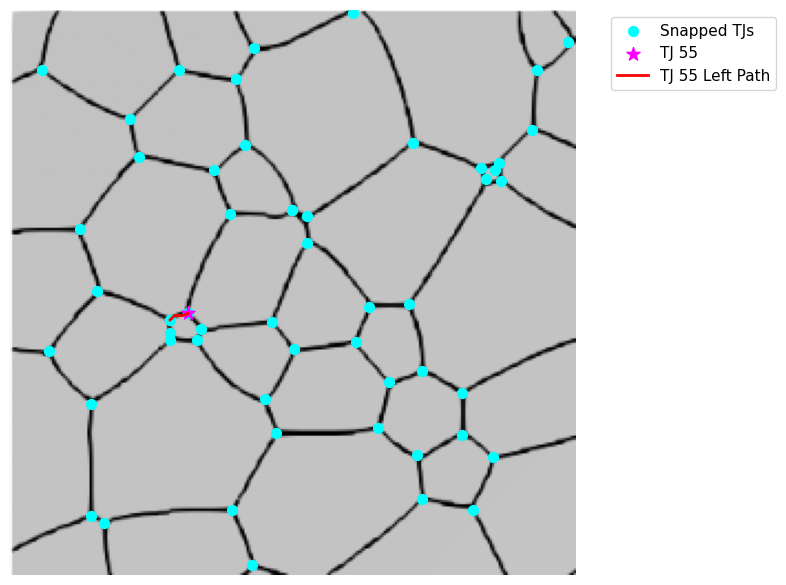

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_55_to_tj_10.png
Path plotted for TJ 55 to TJ 10 (via Left): Reached TJ at 72, 140 in Left (graph distance: 4)
Generating path image: /content/local_outputs/slice64_1 (1)_path_tj_55_to_tj_37.png


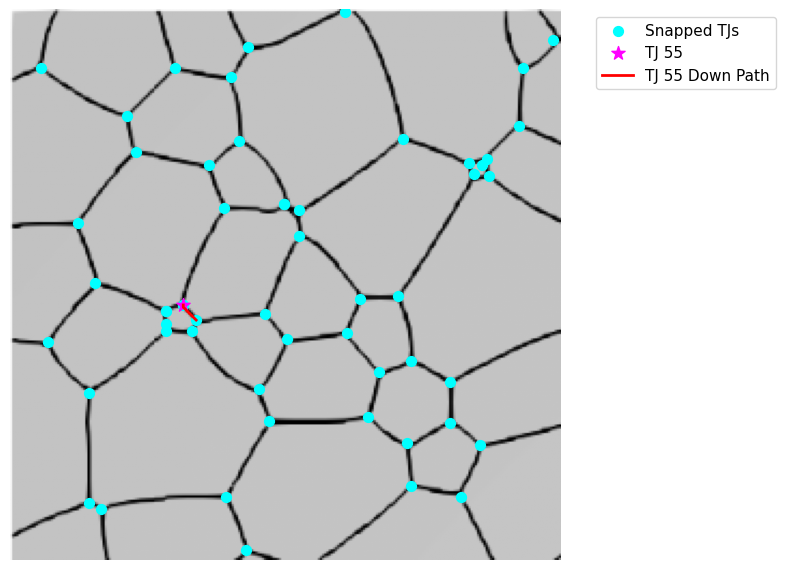

Saved and displayed: /content/local_outputs/slice64_1 (1)_path_tj_55_to_tj_37.png
Path plotted for TJ 55 to TJ 37 (via Down): Reached TJ at 86, 144 in Down (graph distance: 4)
Generated 77 unique TJ pair path images
Saved TJ pair paths to: /content/local_outputs/slice64_1 (1)_tj_pair_paths.txt
Vertices: 55
[(92, 72), (182, 60), (162, 134), (180, 133), (156, 150), (100, 226), (99, 92), (184, 201), (109, 251), (72, 140), (36, 178), (31, 99), (238, 27), (110, 17), (171, 168), (218, 202), (186, 163), (186, 221), (17, 154), (106, 61), (222, 77), (213, 71), (58, 66), (39, 127), (14, 27), (166, 189), (76, 27), (115, 176), (80, 137), (72, 149), (54, 49), (102, 31), (236, 54), (204, 192), (134, 93), (120, 191), (86, 144), (209, 226), (221, 69), (36, 229), (118, 141), (215, 76), (128, 153), (134, 105), (42, 232), (84, 149), (204, 173), (252, 14), (127, 90), (72, 140), (127, 90), (155, 1), (219, 72), (72, 146), (80, 137)]
Edges: 77
[(0, 19), (0, 22), (0, 6), (1, 51), (1, 34), (1, 21), (2, 43), (2

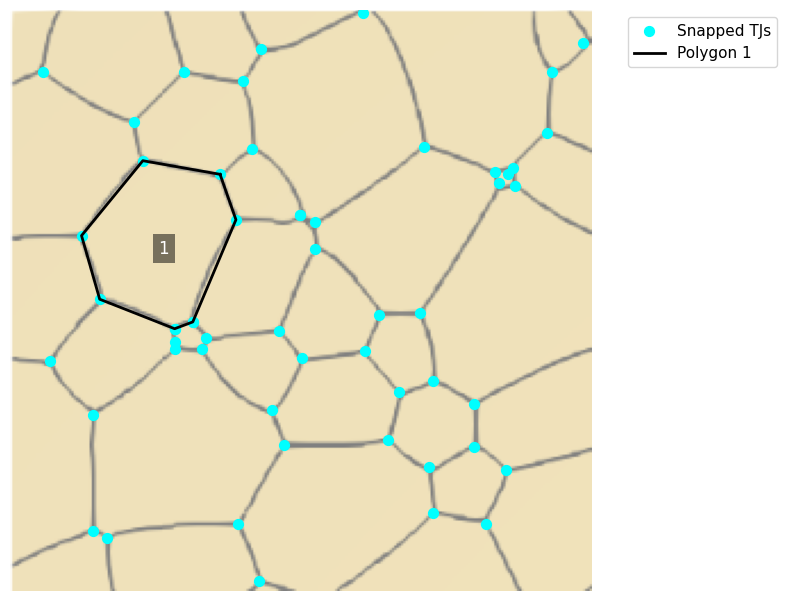

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_1.png


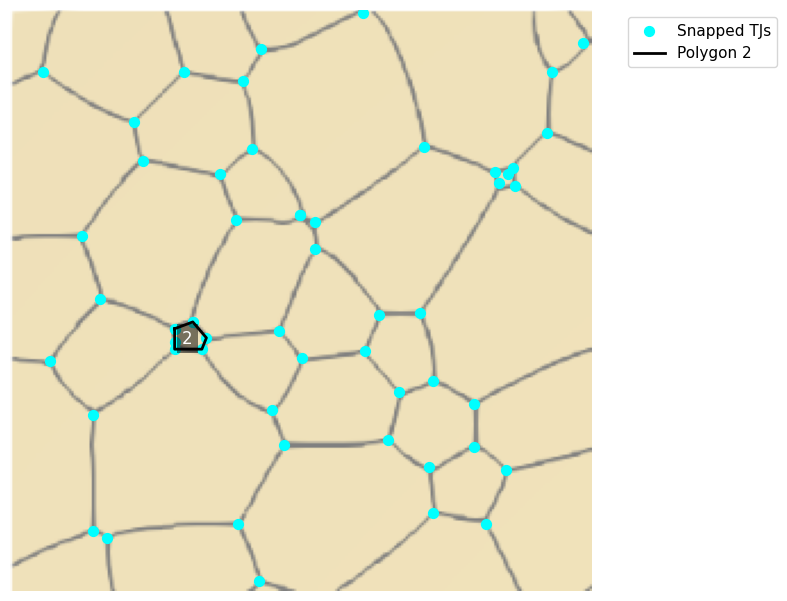

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_2.png


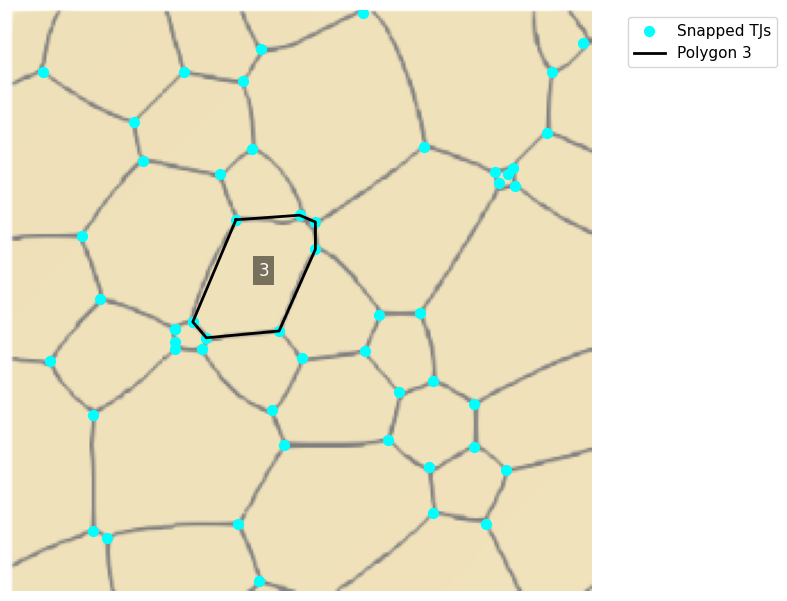

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_3.png


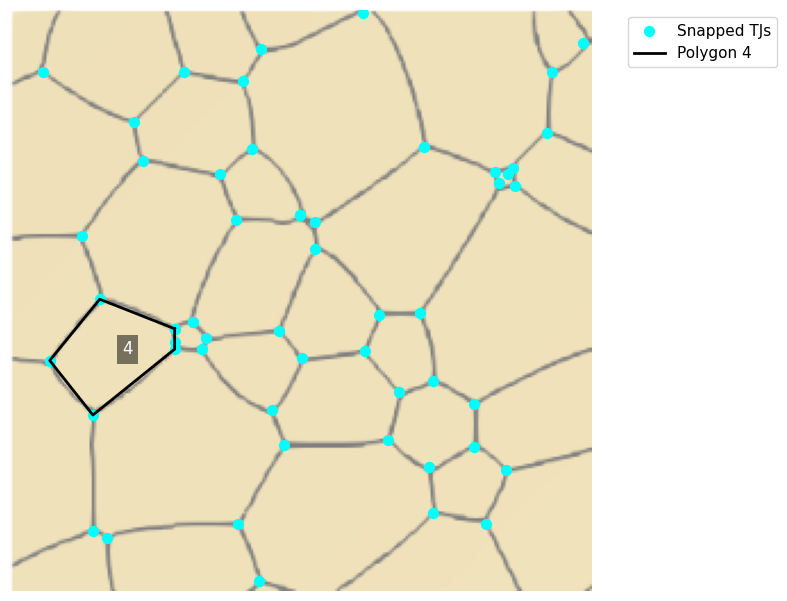

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_4.png


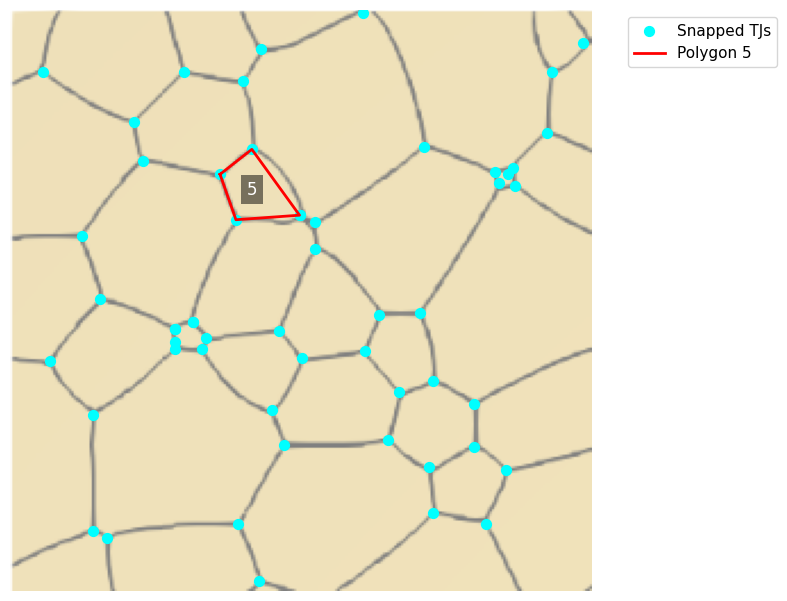

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_5.png


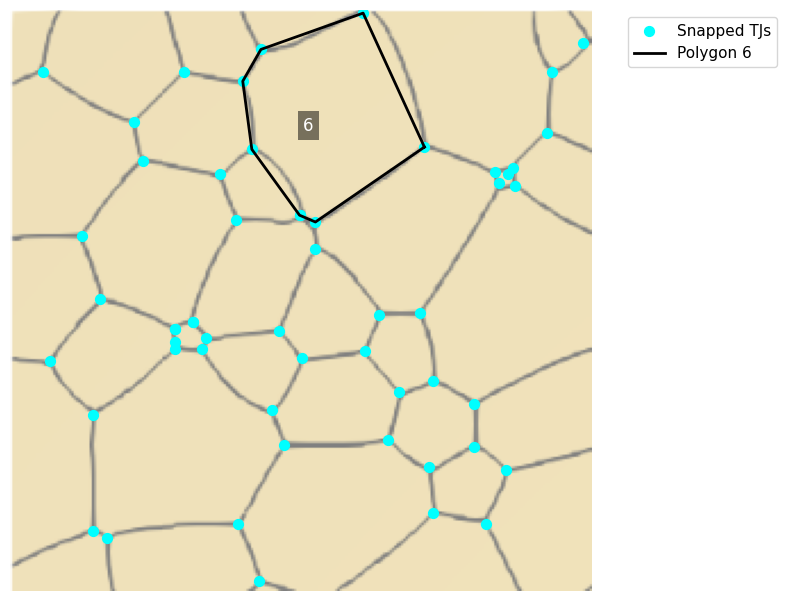

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_6.png


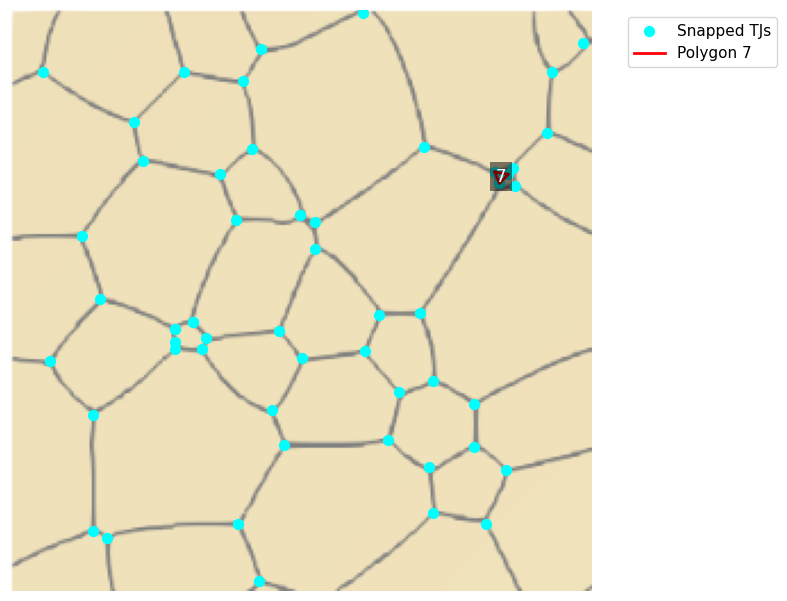

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_7.png


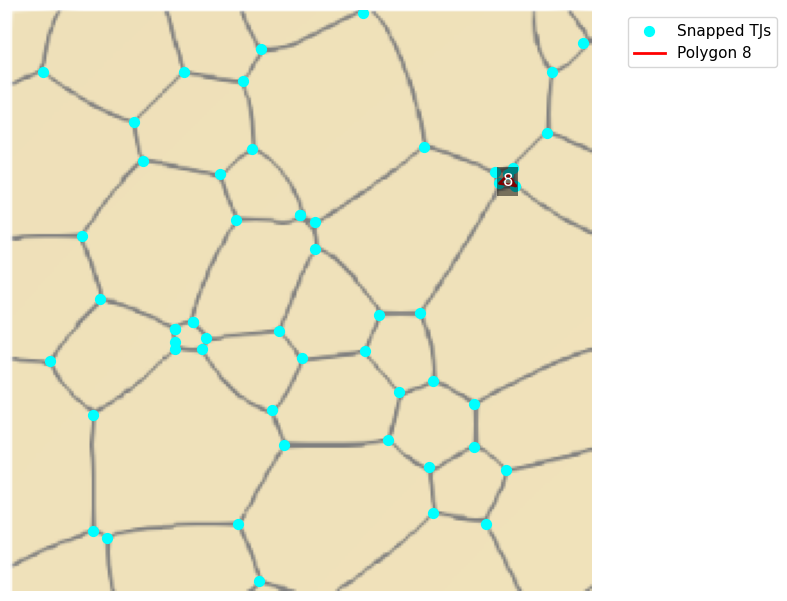

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_8.png


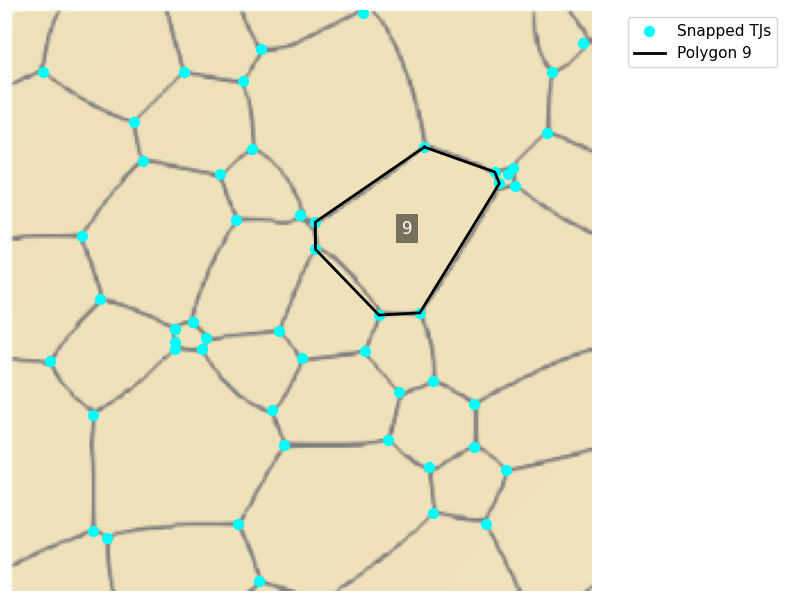

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_9.png


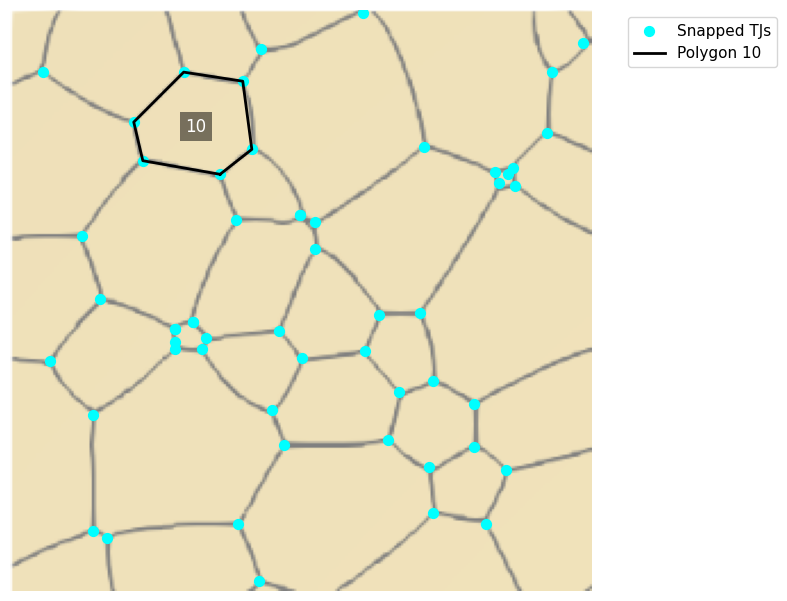

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_10.png


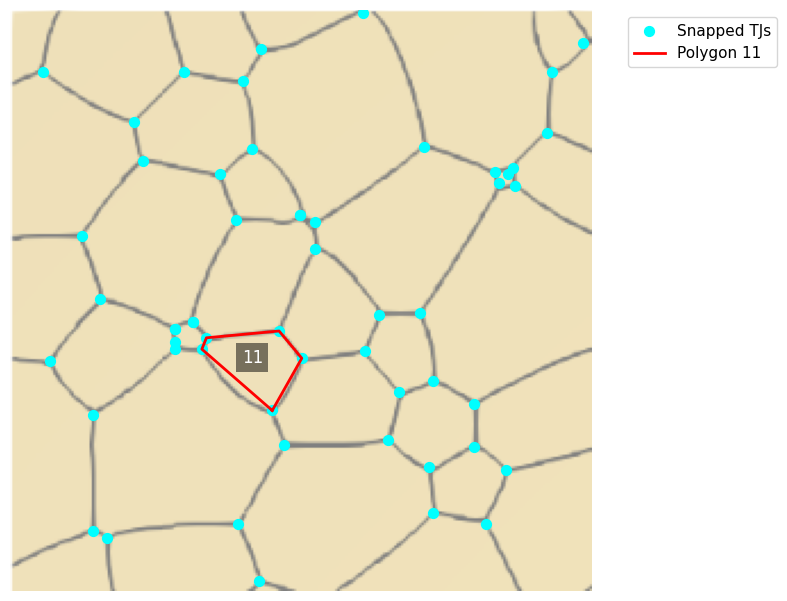

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_11.png


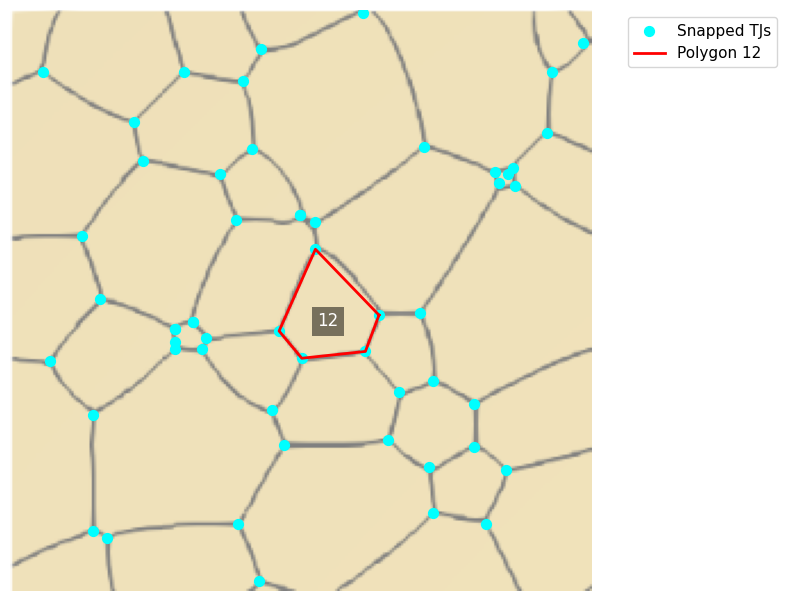

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_12.png


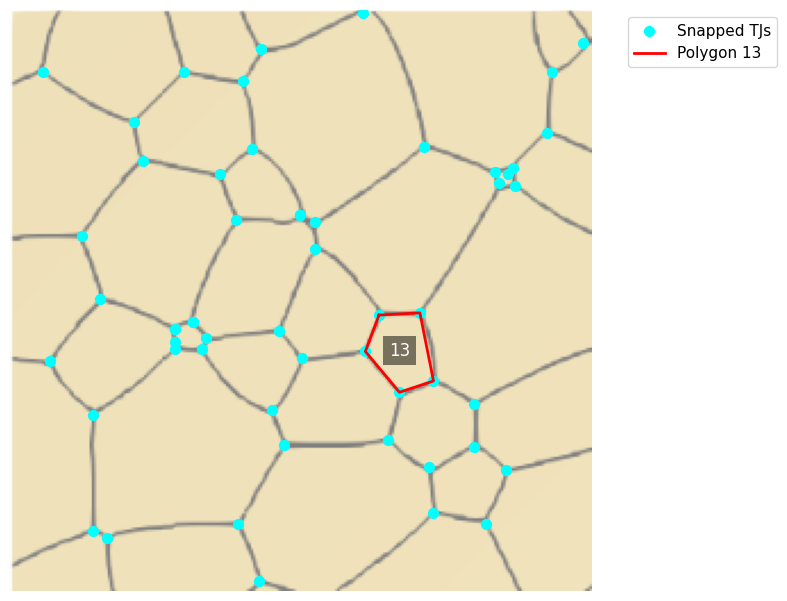

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_13.png


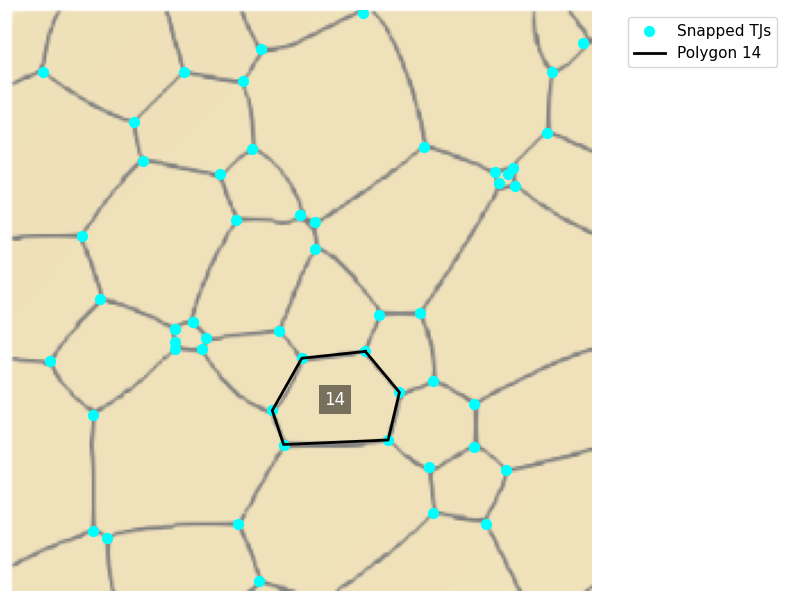

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_14.png


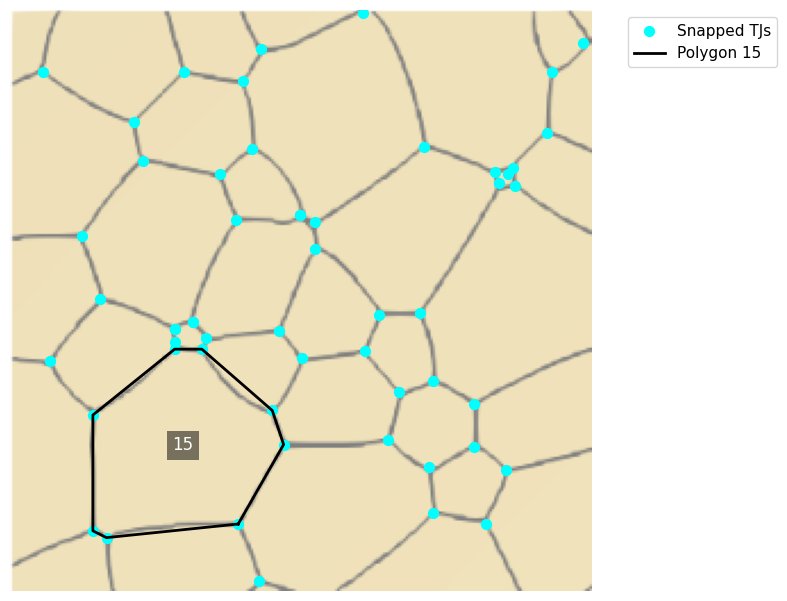

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_15.png


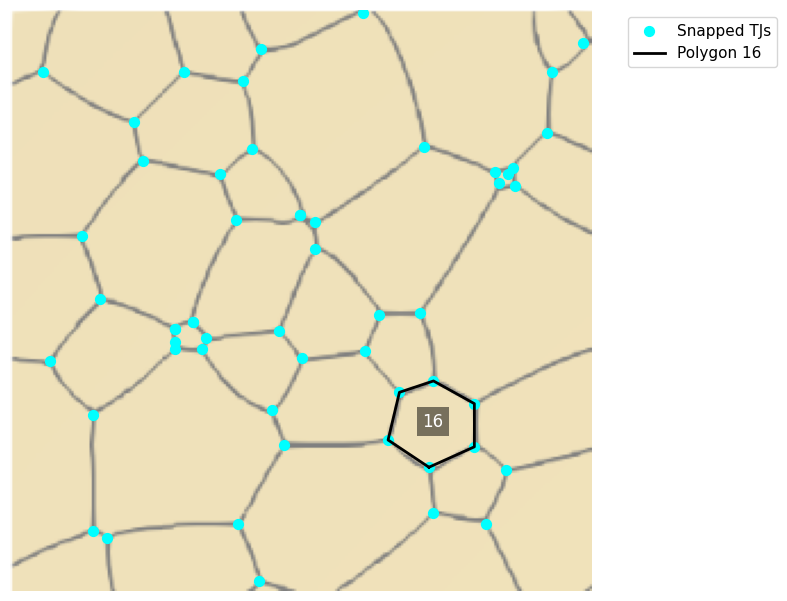

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_16.png


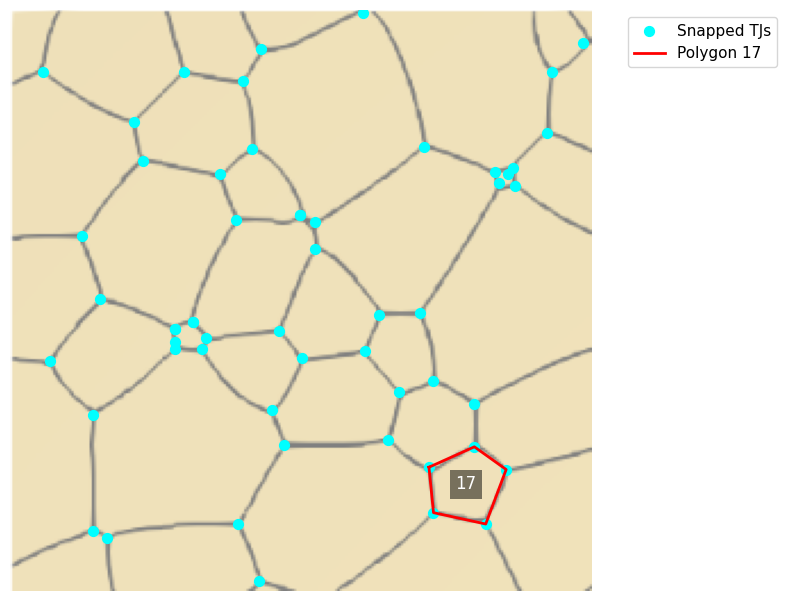

Saved and displayed individual polygon visualization: /content/local_outputs/slice64_1 (1)_polygon_17.png


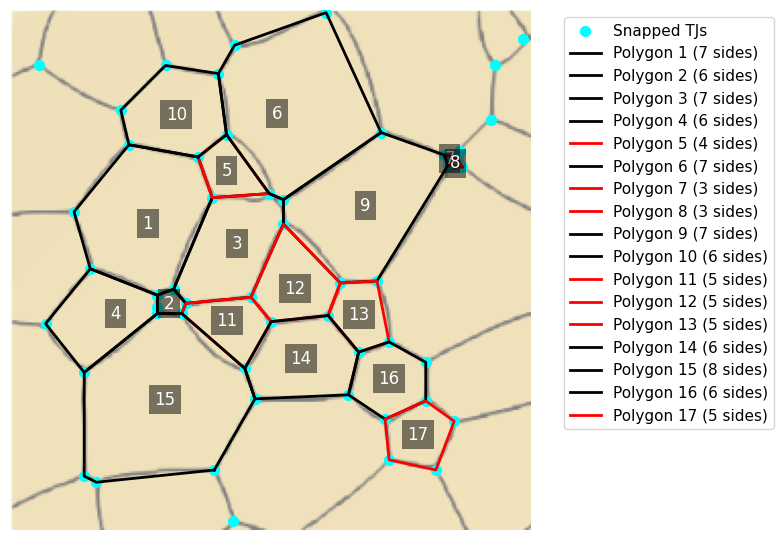

100%|██████████| 1/1 [00:47<00:00, 47.54s/it]

Saved and displayed combined polygon visualization: /content/local_outputs/slice64_1 (1)_polygons.png

Listing files in /content/local_outputs:
slice64_1 (1)_edge_graph.png
slice64_1 (1)_edges.png
slice64_1 (1)_grain_properties.csv
slice64_1 (1)_path_tj_10_to_tj_24.png
slice64_1 (1)_path_tj_10_to_tj_29.png
slice64_1 (1)_path_tj_10_to_tj_54.png
slice64_1 (1)_path_tj_11_to_tj_30.png
slice64_1 (1)_path_tj_11_to_tj_40.png
slice64_1 (1)_path_tj_12_to_tj_23.png
slice64_1 (1)_path_tj_12_to_tj_24.png
slice64_1 (1)_path_tj_13_to_tj_33.png
slice64_1 (1)_path_tj_13_to_tj_48.png
slice64_1 (1)_path_tj_14_to_tj_32.png
slice64_1 (1)_path_tj_14_to_tj_52.png
slice64_1 (1)_path_tj_15_to_tj_17.png
slice64_1 (1)_path_tj_15_to_tj_26.png
slice64_1 (1)_path_tj_16_to_tj_34.png
slice64_1 (1)_path_tj_16_to_tj_38.png
slice64_1 (1)_path_tj_17_to_tj_47.png
slice64_1 (1)_path_tj_18_to_tj_38.png
slice64_1 (1)_path_tj_19_to_tj_11.png
slice64_1 (1)_path_tj_19_to_tj_24.png
slice64_1 (1)_path_tj_1_to_tj_20.png
slice64_1

In [19]:
# --- Main Loop ---
def main():
    print("Starting main loop...")
    for img_path in tqdm(img_paths):
        print(f"\nProcessing image: {img_path}")
        img_name = os.path.basename(img_path)
        img_name_no_ext = os.path.splitext(img_name)[0]
        try:
            results = model(img_path)
            df = results.pandas().xyxy[0]
        except Exception as e:
            print(f"Error in YOLOv5 detection: {e}")
            continue
        tj_points = []
        img_gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        if img_gray is None:
            print(f"Error: Could not load image {img_path}")
            continue
        img_shape = img_gray.shape
        for _, row in df.iterrows():
            x1, y1, x2, y2 = map(int, [row['xmin'], row['ymin'], row['xmax'], row['ymax']])
            box = img_gray[y1:y2, x1:x2]
            if box.size == 0:
                continue
            corners = cv2.goodFeaturesToTrack(box, maxCorners=1, qualityLevel=0.01, minDistance=1)
            if corners is not None:
                cx, cy = corners[0][0]
                tj_points.append((x1 + int(cx), y1 + int(cy)))
            else:
                tj_points.append(((x1 + x2) // 2, (y1 + y2) // 2))
        print(f"Detected {len(tj_points)} TJs")
        gray_img, edge_img = preprocess_image(img_path)
        if gray_img is None or edge_img is None:
            print("Skipping image due to preprocessing failure")
            continue
        edge_graph, edge_points = build_edge_graph(edge_img)
        if edge_graph is None or edge_points is None:
            print("Skipping image due to edge graph failure")
            continue
        edge_graph_path = os.path.join(output_folder, f"{img_name_no_ext}_edge_graph.png")
        visualize_edge_graph(gray_img, edge_graph, edge_points, edge_graph_path)
        snapped_tjs = snap_to_edge_points(tj_points, edge_points)
        print(f"Snapped TJs: {len(snapped_tjs)}")
        print(snapped_tjs)
        coords_out_path = os.path.join(output_folder, f"{img_name_no_ext}_tj_neighbors.txt")
        points_by_direction = save_tj_and_neighbors_to_txt(snapped_tjs, edge_graph, coords_out_path, img_shape)
        visual_out_path = os.path.join(output_folder, f"{img_name_no_ext}_tj_outputs.png")
        visualize_tj_neighbors(gray_img, snapped_tjs, edge_graph, visual_out_path)
        print("Generating unique TJ pair path images and saving paths to text file...")
        direction_names = ['Up-Left', 'Up', 'Up-Right', 'Left', 'Right', 'Down-Left', 'Down', 'Down-Right']
        path_count = 0
        seen_pairs = set()
        tj_pair_paths = {}
        tj_pair_paths_txt = os.path.join(output_folder, f"{img_name_no_ext}_tj_pair_paths.txt")
        with open(tj_pair_paths_txt, 'w') as f:
            f.write("Connected Triple Junction Pairs and Their Paths (x, y):\n")
        for i, tj in enumerate(snapped_tjs):
            tj = tuple(map(int, tj))
            tj_node = (tj[1], tj[0])
            if tj_node not in edge_graph:
                print(f"TJ {i+1} at {tj} not in edge graph, skipping")
                continue
            for dir_idx, direction in enumerate(direction_names):
                path, reason = trace_path_to_next_tj(tj, edge_graph, dir_idx, snapped_tjs, img_shape)
                if path:
                    end_x, end_y = path[-1]
                    end_tj = (end_x, end_y)
                    end_idx = None
                    for j, other_tj in enumerate(snapped_tjs):
                        if j != i and tuple(map(int, other_tj)) == end_tj:
                            end_idx = j
                            break
                    if end_idx is not None:
                        pair = tuple(sorted([i, end_idx]))
                        if pair not in tj_pair_paths or len(path) < len(tj_pair_paths[pair][0]):
                            tj_pair_paths[pair] = (path, dir_idx, direction, i, end_idx, reason)
                else:
                    print(f"No path for TJ {i+1} {direction}: {reason}")
        for pair, (path, dir_idx, direction, start_idx, end_idx, reason) in tj_pair_paths.items():
            if pair not in seen_pairs:
                start_tj = tuple(map(int, snapped_tjs[start_idx]))
                end_tj = tuple(map(int, snapped_tjs[end_idx]))
                path_out_path = os.path.join(output_folder, f"{img_name_no_ext}_path_tj_{start_idx+1}_to_tj_{end_idx+1}.png")
                visualize_individual_direction_path(gray_img, path, start_tj, start_idx, dir_idx, snapped_tjs, path_out_path)
                path_count += 1
                seen_pairs.add(pair)
                print(f"Path plotted for TJ {start_idx+1} to TJ {end_idx+1} (via {direction}): {reason}")
                with open(tj_pair_paths_txt, 'a') as f:
                    f.write(f"\nTJ Pair: TJ {start_idx+1} to TJ {end_idx+1}\n")
                    f.write(f"Start TJ {start_idx+1}: {start_tj[0]}, {start_tj[1]}\n")
                    f.write(f"End TJ {end_idx+1}: {end_tj[0]}, {end_tj[1]}\n")
                    f.write("Path Coordinates (x, y):\n")
                    for x, y in path:
                        f.write(f"  {x:.2f}, {y:.2f}\n")
                    f.write(f"Reason: {reason}\n")
        print(f"Generated {path_count} unique TJ pair path images")
        print(f"Saved TJ pair paths to: {tj_pair_paths_txt}")
        vertices = [tuple(map(int, tj)) for tj in snapped_tjs]
        edges = [(pair[0], pair[1]) for pair in tj_pair_paths.keys()]
        print(f"Vertices: {len(vertices)}")
        print(vertices)
        print(f"Edges: {len(edges)}")
        print(edges)
        polygons_txt_path = os.path.join(output_folder, f"{img_name_no_ext}_polygons.txt")
        polygons_img_path = os.path.join(output_folder, f"{img_name_no_ext}_polygons.png")
        polygons = reconstruct_polygons(vertices, edges, polygons_txt_path, polygons_img_path, gray_img, snapped_tjs, img_path)
        print(f"\nListing files in {output_folder}:")
        for file in sorted(os.listdir(output_folder)):
            print(file)

if __name__ == "__main__":
    try:
        main()
    except Exception as e:
        print(f"Error in main execution: {e}")